In [85]:
#from google.colab import drive
#drive.mount('/content/gdrive')

In [86]:
#cd '/content/gdrive/My Drive/Colab Notebooks/Vision por Computador'

In [87]:
import math
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt

# Funciones Auxiliares

In [88]:
def joinPlotTitles(vim,vti,raws):  
    #Calculamos el número de columnas
    colum = int(len(vim)/raws)  
    #Para cada imagen hacemos un subplot y mostramos la figura con su título
    for i in range(len(vim)):
        plt.subplot(raws,colum,1+i)
        plt.plot(vim[i])
        plt.title(vti[i])
        plt.axis('off')
        
'''
Función que muestra en una única ventana varias imágenes con sus respectivos títulos
    - vim:  Vector de imágenes
    - vti:  Vector de títulos
    - raws: Número de filas que queremos que tenga la representación
'''
def joinImgTitles(vim,vti,raws):  
    #Calculamos el número de columnas
    col = int(len(vim)/raws)  
    #Para cada imagen hacemos un subplot y mostramos la figura con su título
    for i in range(len(vim)):
        plt.subplot(raws,col,1+i)
        plt.imshow(vim[i][:,:,::-1] if vim[i].ndim == 3 else vim[i], cmap='gray')
        plt.title(vti[i])
        plt.axis('off')
        
"""
Función que normaliza una matriz pasada como parámetro
"""
def normalizar(mat):
  return (mat-mat.min())/(mat-mat.min()).max()
        

"""
Función que muestra una imagen normalizada con sus respectivos títulos
"""
def show_nimages(vim, titles, ident = None, ncol = 2, figsize=(15,15)):
  
  fig = plt.figure(num=ident, figsize=figsize)
    
  for i, imag in enumerate(vim):
    subimagen = fig.add_subplot( math.ceil(len(vim)/ncol), ncol, i + 1 )
    plt.title(titles[i])
    plt.axis('off')
    subimagen.imshow(normalizar(imag), cmap='gray' if len(imag.shape)==2 else None)
  plt.show()





# Ejercicio 1

## Ejercicio 1-A

In [89]:
"""
Funciones Auxiliares para la implementación del ejercicio.
Presentamos la función gaussiana de media cero y dependiente del sigma y la variable, 
así como su primera y segunda derivada
"""
def gaussian(x,sigma):
    return math.exp(-(x**2)/(2*sigma**2))

def gaussian_dx(x,sigma):
    return math.exp( -(x**2)/(2*sigma**2) ) * (-x/sigma**2)

def gaussian_dxdx(x,sigma):
    return math.exp( -(x**2)/(2*sigma**2) ) * (-(sigma**2) + x**2)/(sigma**4)




"""
    Función que calcula la máscara discreta Gaussiana.
    @param:
        -sigma: indica la desviación típica de la gaussiana
        -dim:   dimensión que queremos que tenga la máscara
        -dx:    Derivada (0,1,2)
        
    @Predondicion:
        Debemos especificar o bien el "sigma" o bien "dim", pero no los dos, ya que uno se calcula
        en función del otro. 
"""
def discrete_gaussian_mask(sigma=None,dim=None,dx=0):

    #Calculamos sigma o la longitud del vector en función de si tenemos uno u otro
    if sigma == None and dim != None:
        sigma = (dim-1)/6
    elif dim == None and sigma != None:
        dim = math.ceil(sigma*3)*2 + 1
        
    #Calculamos el punto intermedio del vector impar
    k=math.ceil(sigma*3)
    
    #Creamos la máscara gaussiana discretizada de tamaño "dim" 
    if dx == 0:   
        mask = np.asarray([gaussian(i - k,sigma) for i in range(dim)])
        #Normalizamos la máscara para que la suma de sus valores sea 1
        mask = mask/sum(mask) 
    elif dx == 1: 
        mask = np.asarray([gaussian_dx(i - k,sigma) for i in range(dim)])
    else:         
        mask = np.asarray([gaussian_dxdx(i - k,sigma) for i in range(dim)])
    

    
    return mask,sigma,dim


In [90]:
def ejercicio1A():
    
    
    sigmas = [1.3,4,3,5]
    dims    = [5,7]
    
    for sigma in sigmas:
        print("\nPresentamos las máscaras Gausiana, su primera y segunda derivda de sigma ", sigma)
        mask1 = discrete_gaussian_mask(sigma,dx=0)
        mask2 = discrete_gaussian_mask(sigma,dx=1)
        mask3 = discrete_gaussian_mask(sigma,dx=2)

        plt.plot(mask1[0],marker="o")
        plt.plot(mask2[0],marker="o")
        plt.plot(mask3[0],marker="o")
        plt.legend(["Gaussiana", "Derivada 1ª","Derivada 2ª"])
        plt.show()

        print("Las tres presentan una tamaño de ", mask1[2])

    for dim in dims:
        print("\nPresentamos las máscaras Gaussiana, su primera y segunda derivada de longitud",dim )
        mask1 = discrete_gaussian_mask(sigma = None, dim=dim,dx=0)
        mask2 = discrete_gaussian_mask(sigma = None, dim=dim,dx=1)
        mask3 = discrete_gaussian_mask(sigma = None, dim=dim,dx=2)  
        
        plt.plot(mask1[0],marker="o")
        plt.plot(mask2[0],marker="o")
        plt.plot(mask3[0],marker="o")
        plt.legend(["Gaussiana", "Derivada 1ª","Derivada 2ª"])
        plt.show()    
        
        print("Las tres presentan una sigma de ", mask1[1])
        
    # Usamos la función getDerivKernels
    sigma=None
    dim=9
    sobel = cv.getDerivKernels(1,0,9)
    mask1 = discrete_gaussian_mask(sigma,dim,dx=0)
    mask2 = discrete_gaussian_mask(sigma,dim,dx=1)


    print("\nGET DERIV KERNELS")
    plt.plot(sobel[1])
    plt.plot(sobel[0])
    plt.legend(["Gaussiana", "Derivada 1ª"])
    plt.show()


    print("Filtro Gaussiano propio y filtro obtenido con getDerivKernel Normalizados")
    plt.plot(mask1[0])
    plt.plot(sobel[1]/sum(sobel[1]))
    plt.legend(["Gaussiana","Gaussiana_getDerivKernels"])
    plt.show()
    
    print("getDerivKernel smooth: ",sobel[1].T/(sum(sobel[1])))
    print("getDerivKernel derivative dx: ", sobel[0].T)
    print("kernel Gaussiano implementado: ", mask1[0].T)
    print("Derivada Kernel Gaussiano implementado: ", mask2[0].T)

In [91]:
#ejercicio1A()

## Ejercicio 1-B

In [92]:
"""
Calcula las máscaras discretas 1D de longitud 5 y 7 
    @param:
        -) dx: indica la derivada 
            0                    --> filtro Gaussiano
            Cualquier otro valor --> primera derivada
    @return:
    
"""
def discrete_mask_by_binomial_kernel(dx = 0):
    #Partimos de la máscara Gaussiana y de la derivada de longitud 3
    kernel   = [1,2,1]
    kerneldx = [-1,0,1]
    
    #Calculamos el filtro Gaussiano o la derivada
    #Tenemos en cuenta la propiedad asociativa y conmutativa la gausiana
    if dx == 0:
        mg5 = np.convolve(kernel,kernel)
        mg7 = np.convolve(kernel,mg5)
        mg9 = np.convolve(mg7,kernel)
    else:
        mg5 = np.convolve(kernel,kerneldx)
        mg7 = np.convolve(mg5,kernel)
        mg9 = np.convolve(mg7,kernel)
    
    return mg5,mg7,mg9

In [93]:
def ejercicio1B():

    #Calculamos las máscaras de alisamiento de tamaño 5 y 7 y la derivada de tamaño 3
    masc  = discrete_mask_by_binomial_kernel(0)
    mascd = discrete_mask_by_binomial_kernel(1)
    #Ejecutamos función get deriv kernel
    getderiv = cv.getDerivKernels(0,1,9)
    #Comparamos máscaras de tamaño 9 con las de get DerivKernel
    vti = ["getDeriv_dx","binomial_kernel_dx","getDeriv_smooth","binomial_kernel_smooth"]
    vim = [getderiv[1],mascd[2],getderiv[0],masc[2]]
    joinPlotTitles(vim,vti,2)
    
   
    print("Máscara discreta de longitud 5: ",masc[0])
    print("Máscara discreta de longitud 7: ",masc[1])
    print("Máscara discreta derivada de longitud 5: ",mascd[0])
    print("Máscara discreta derivada de longitud 7: ",mascd[1])
    print("====================================================")
    print("Máscara discreta de longitud 9: ",masc[2])
    print("GetDerivKernel smooth: ",getderiv[0].T)
    print("Máscara discreta derivada de longitud 9: ", mascd[2])
    print("GetDerivKernel dx: ",getderiv[1].T)

Máscara discreta de longitud 5:  [1 4 6 4 1]
Máscara discreta de longitud 7:  [ 1  6 15 20 15  6  1]
Máscara discreta derivada de longitud 5:  [-1 -2  0  2  1]
Máscara discreta derivada de longitud 7:  [-1 -4 -5  0  5  4  1]
Máscara discreta de longitud 9:  [ 1  8 28 56 70 56 28  8  1]
GetDerivKernel smooth:  [[ 1.  8. 28. 56. 70. 56. 28.  8.  1.]]
Máscara discreta derivada de longitud 9:  [ -1  -6 -14 -14   0  14  14   6   1]
GetDerivKernel dx:  [[ -1.  -6. -14. -14.   0.  14.  14.   6.   1.]]


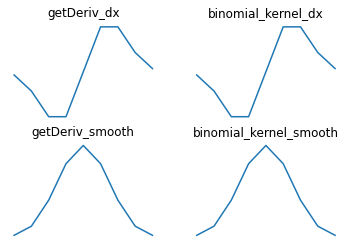

In [94]:
ejercicio1B()

## Ejercicio 1-C

In [95]:
"""
Calcula la correlacion por columnas de la fila pasada como argumento con la matriz imagen y la máscara
    @Param:
        - imagen: matriz 2D
        - kernel: mascara (array unidimensional)
        - fila:    indice de una fila de la matriz
"""
def correlacion_col(imagen,kernel,fila):
    radio = math.ceil((len(kernel)-1)/2)
    return np.sum((imagen[i-radio:i+radio+1,:].T*mask).T,axis=0)


"""
    Realiza un padding en negro a la matriz
    @param:
        - imagen: Imagen a la que le haremos el padding
        - tam:    número de pixeles a añadir a los extremos de las filas y las ccolumnas en la matriz
    @Return:
        - Matriz padding
"""
def padding_2D(imagen,tam,modo_padding="reflejado"):
    
    if modo_padding == "negro":
        #Introducimos el padding en las filas
        aux = np.zeros((imagen.shape[0],tam))
        padding = np.concatenate((aux,imagen,aux),axis=1)

        #Introducimos el pading en las columnas
        aux2= np.zeros((padding.shape[1],tam))
        padding = (np.concatenate((aux2,padding.T,aux2),axis=1)).T
    
    elif modo_padding == "reflejado":
        #Introducimos el padding por filas
        reflizq = imagen[:,0:tam].T[::-1]
        refleder = imagen[:,imagen.shape[1]-tam:imagen.shape[1]].T[::-1]
        padding = np.concatenate((reflizq.T,imagen,refleder.T),axis = 1)
        #Introducimos el padding por columnas
        refleup = padding[0:tam,:][::-1]
        refledown = padding[padding.shape[0]-tam:padding.shape[0],:][::-1]
        padding = np.concatenate((refleup,padding,refledown),axis=0)
        
    return padding


"""
    Calcula la correlacion de una matriz con una máscara 2D aprovechando la separabilidad de la Gaussiana.
    @Precondition:
        -kernelv y kernelh deben ser máscaras Gaussianas
    @Param:
        -imagen: matriz 2D
        -kernelv, kernelh: máscaras horizontal y vertical (ambas son un array 1D)

"""


def correlacion_2D(imagen,kernelv,kernelh,modo_padding="negro"):
     
    #Calculamos el radio del kernel, hacemos padding en la imagen y guardamos sus dimensiones
    radiov = math.ceil((len(kernelv)-1)/2)
    radioh = math.ceil((len(kernelh)-1)/2)
    imagen_padding = padding_2D(imagen,radioh,modo_padding)
    imagen_fils    = imagen_padding.shape[0]
    imagen_cols    = imagen_padding.shape[1]
    
    #Convolución columnas
    #Hay un ejemplo en la memoria explicando que es lo que se hace en esta línea de código
    #Básicamente para cada fila se extrae una submatriz de la matriz para aplicarle el producto escalar con el vector y original y producir otra matriz
    mat_col = np.asarray([np.sum((imagen_padding[i-radiov:i+radiov+1,:].T*kernelv).T,axis=0) for i in range(radiov,imagen_fils-radiov)])

    #Convolucion por filas
    mat_corr = np.asarray ([ np.sum((mat_col[:,j-radioh:j+radioh+1]*kernelh),axis=1) for j in range(radioh,imagen_cols-radioh)]).T
    
    return mat_corr

"""
Función que realiza una convolucion de una imagen con un filtro 2D usando la separabilidad a partir de los dos kernels
pasados como argumento.
"""
def convolucion_2D(image, kernelh, kernelv,modo_padding="negro"):
  return correlacion_2D(image, kernelh[::-1], kernelv[::-1],modo_padding)


"""
Función que suaviza la imagen pasada como argumento con un filtro gaussiano calculado a apartir del sigma pasado
"""
def suavizar(imagen,sigma,modo_padding="negro"):
    #Vemos si la imagen es tribanda o monocolor
    gris = len(imagen.shape)
    
    #Calculamos la mascara
    kernel = discrete_gaussian_mask(sigma=sigma,dim=None,dx=0)[0]
    
    #Si es monobanda tiene dos dimensiones, si no es tribanda (a color)
    if gris == 2:
        return convolucion_2D(imagen,kernel,kernel,modo_padding)
    else:
        ret = imagen
        r = convolucion_2D(imagen[:,:,0],kernel,kernel,modo_padding)[:,:,np.newaxis]
        g = convolucion_2D(imagen[:,:,1],kernel,kernel,modo_padding)[:,:,np.newaxis]
        b = convolucion_2D(imagen[:,:,2],kernel,kernel,modo_padding)[:,:,np.newaxis]
        return np.concatenate((r,g,b),axis=2)

"""
    Funcicón auxiliar que calcula la media de la intensidad de una matrix a nivel de píxeles
"""
def media_matrix(mat):
    return np.sum(mat) / (mat.shape[0]*mat.shape[1])

"""
Función auxiliar para calcular el error cuadrático medio de dos imagenes
"""
def MSE(a,b):
    diff = (a - b)**2
    suma = np.sum(diff)
    return suma


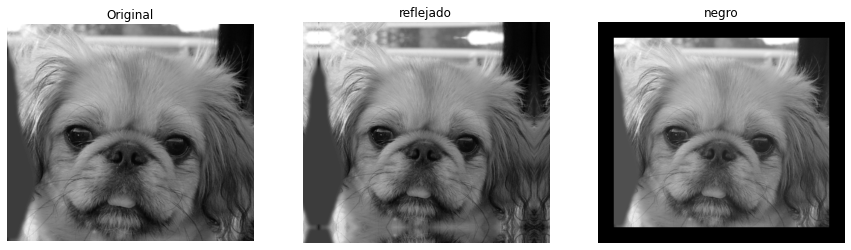

In [96]:
imagen1 = cv.imread('data/dog.bmp',0).astype(np.float64)
tam = 30

img2 = padding_2D(imagen1,tam,"reflejado")
img3 = padding_2D(imagen1,tam,"negro")

show_nimages([imagen1,img2,img3],["Original","reflejado","negro"],ncol=3)

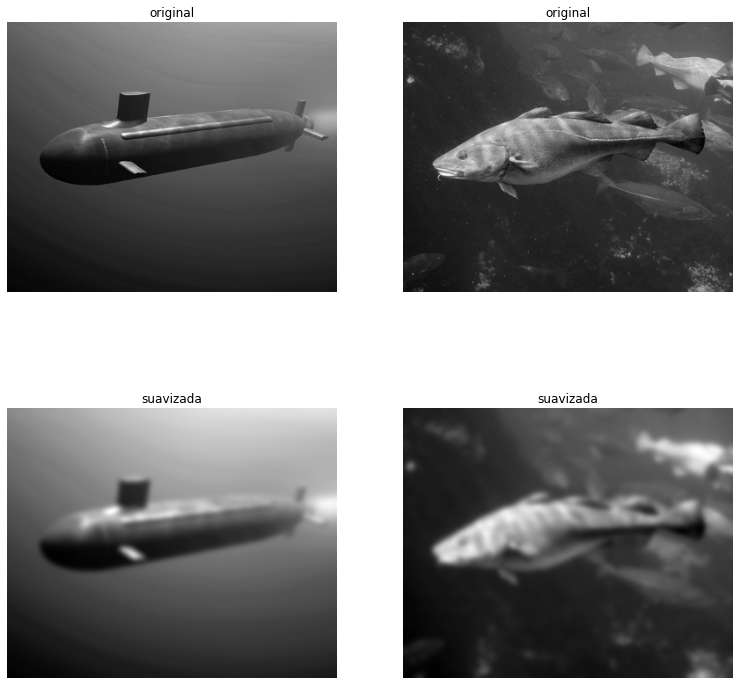

In [97]:
#Leemos las imágenes para el experimento
imagen1 = cv.imread('data/submarine.bmp',0).astype(np.float64)
imagen2 = cv.imread('data/fish.bmp',0).astype(np.float64)
modo_padding = "reflejado"
#Definimos sigma y suavizamos las imágenes
sigma=3
img1smooth = suavizar(imagen1,sigma,modo_padding)
img2smooth = suavizar(imagen2,sigma,modo_padding)

#Visualizamos las imágenes
vim = [imagen1,imagen2,img1smooth,img2smooth]
titles = ["original","original","suavizada","suavizada"]
show_nimages(vim, titles, ident = "ejc1C",figsize=(13,13),ncol=2)



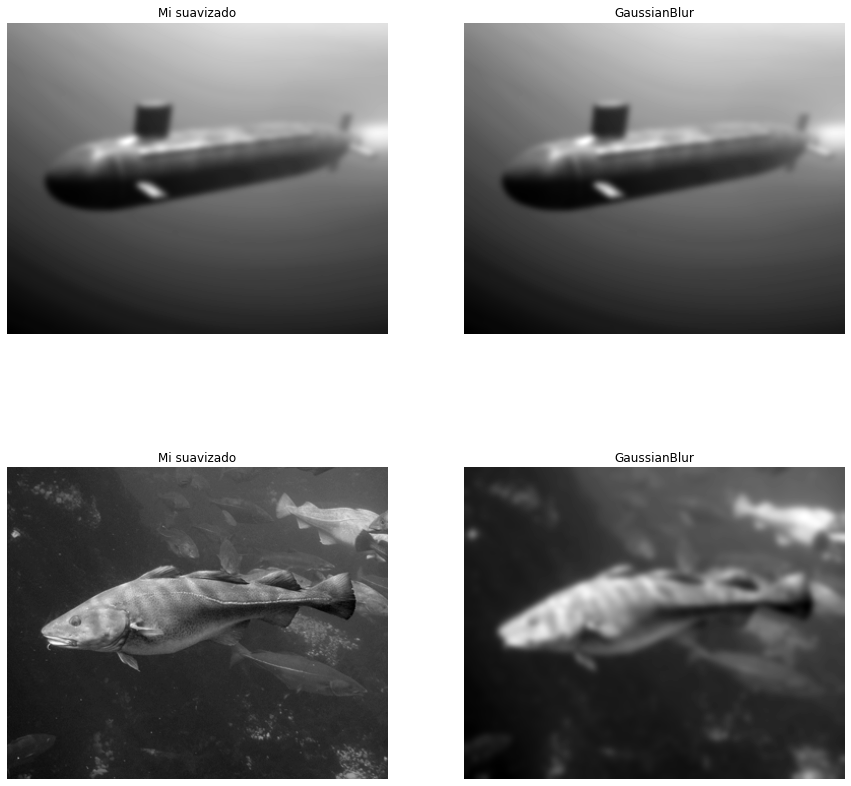

In [98]:
## AHORA USAMOS LA FUNCION GAUSSIANBLUR DE OPENCV

#Leemos las imagenes del experimento
sub  = cv.imread('data/submarine.bmp', 0).astype(np.float64)
pez = cv.imread('data/fish.bmp', 0).astype(np.float64)
moddo_padding = "reflejado"
#Definimos un sigma y creamos el filtro gaussiano 
sigma=3


#Ejecutamos nuestro suavizado y GassianBlur
sub_blur  = cv.GaussianBlur(sub, (0,0), sigmaX=sigma)
pez_blur  = cv.GaussianBlur(pez, (0,0), sigmaX=sigma)
sub_suv   = suavizar(sub, sigma,modo_padding)
pez_suv   = suavizar(pez,sigma,modo_padding)




#Visualizamos las imágenes 
titles = ["Mi suavizado","GaussianBlur","Mi suavizado","GaussianBlur"]
vim    = [sub_suv,sub_blur,pez,pez_blur]
show_nimages(vim,titles, ncol=2)


Imágenes de diferencias: 


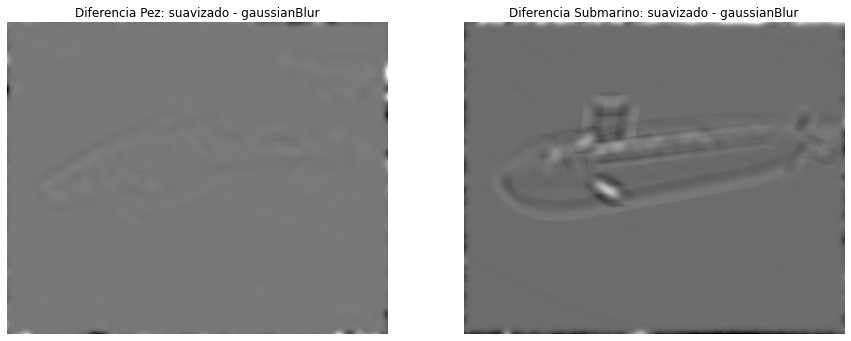

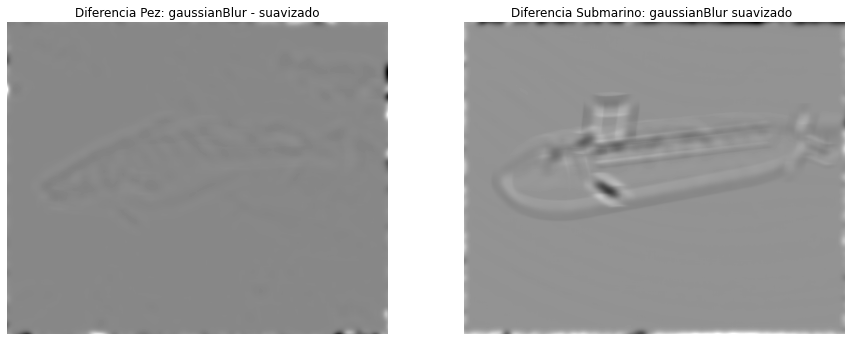

Error Cuadrático Medio: 
Pez         -->  1155.0203175824006
Submarino   -->  50.87655729373286
Diferencia entre los valores máximos: 
Pez         -->  0.09640354057401623
Submarino   -->  0.11133431421802698
Diferencia entre los valores máximos: 
Pez         -->  -0.09246471992460314
Submarino   -->  -0.11145127185596237


In [99]:
#Realizamos algunos otros cálculos de comparación --> EXPLICADOS EN LA MEMORIA

#Calculamos la diferencia de la imágenes alternando el minuendo y el sustraendo
diff2 = cv.subtract(pez_blur ,pez_suv)
diff1 = cv.subtract(sub_blur,sub_suv)

diff2b = cv.subtract(pez_suv ,pez_blur)
diff1b = cv.subtract(sub_suv,sub_blur)



#Visualizamos dichas diferencias
print("Imágenes de diferencias: ")
titles = ["Diferencia Pez: suavizado - gaussianBlur","Diferencia Submarino: suavizado - gaussianBlur"]
titles2 = ["Diferencia Pez: gaussianBlur - suavizado","Diferencia Submarino: gaussianBlur suavizado "]
vim  = [diff2b, diff1b]
vim2 = [diff2,diff1]
show_nimages(vim,titles,ncol=2)
show_nimages(vim2,titles2,ncol=2)

##Calculamos ahora otras estadísticas

# Error Cuadrático Medio
mse_pez = MSE(pez_suv,pez_blur)
mse_sub = MSE(sub_suv,sub_blur)

# Diferencia entre píxeles con valores más altos y mas bajos
diff_max_pez = pez_suv.max() - pez_blur.max()
diff_min_pez = pez_suv.min() - pez_blur.min()

diff_max_sub = sub_suv.max() - sub_blur.max()
diff_min_sub = sub_suv.min() - sub_blur.min()


print("Error Cuadrático Medio: ")
print("Pez         --> ",mse_pez)
print("Submarino   --> ",mse_sub)
print("=========================")
print("Diferencia entre los valores máximos: ")
print("Pez         --> ", diff_max_pez)
print("Submarino   --> ", diff_max_sub)
print("Diferencia entre los valores máximos: ")
print("Pez         --> ", diff_min_pez)
print("Submarino   --> ", diff_min_sub)

    






### Ejercicio 1C.b
    

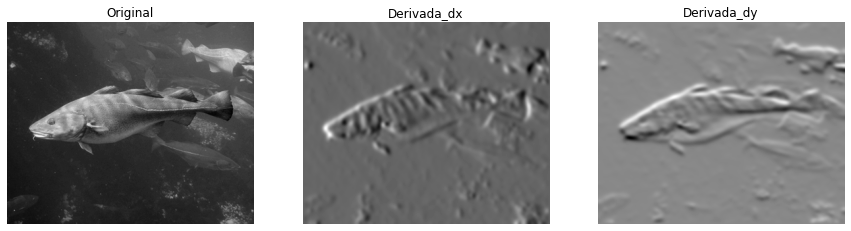

In [100]:
#Leemos la imagen
img = cv.imread("data/fish.bmp",0).astype(np.float64)
modo_padding = "reflejado"
#Calculamos las máscaras del ejercicio 1A
sigma     = 3
gauss     = discrete_gaussian_mask(sigma,dx=0)[0]
gaussd1   = discrete_gaussian_mask(sigma,dx=1)[0]*sigma
gaussdd2  = discrete_gaussian_mask(sigma,dx=2)[0]*sigma**2

#Calculamos la imagen aplicándole el filtro derivado en la dirección del eje x y del eje y
#Ojo, está al revés, el filtro derivada se pone en el primer parámetro para hacer la imagen derivada de y
#y en el segundo parámetro para hacer el filtro derivado con respecto de x
img_dx = convolucion_2D(img, gauss, gaussd1,modo_padding)
img_dy = convolucion_2D(img, gaussd1, gauss,modo_padding)

#Mostramos las imagenes
vim = [img,img_dx,img_dy]
titles = ["Original","Derivada_dx","Derivada_dy"]
show_nimages(vim,titles,ncol=3)

## Ejercicio 1D 

In [101]:
"""
Función que calcula la laplaciana de una gaussiana
"""
def laplacian_of_gaussian(img,sigma):
    #Calculamos las máscaras correspondientes al ejericio 1A
    gauss     = discrete_gaussian_mask(sigma,dx=0)[0]
    gaussd1   = discrete_gaussian_mask(sigma,dx=1)[0]
    gaussdd2  = discrete_gaussian_mask(sigma,dx=2)[0]
    
    #Calculamos el tamaño porque de las máscaras porque nos conviene devolverlo
    tam = len(gaussdd2)
    
    #Calculamos las derivadas segundas en ambas direcciones y el laplaciano normalizado
    mask_dxx = convolucion_2D(img,gauss,gaussdd2,modo_padding)
    mask_dyy = convolucion_2D(img,gaussdd2,gauss,modo_padding)
    laplaciano = (mask_dxx + mask_dyy)*sigma**2
    
    return laplaciano, mask_dxx, mask_dyy, tam

"""
Función que calcula la laplaciana de una gaussiana usando funciones de opencv
    - img: imagen a la que le calcularemos la laplaciana
    - tam: tamaño que queremos que tenga el kernel de la placiana
"""
def laplacian(img,tam):
    ddepth = cv.CV_64F
    lap = cv.Laplacian(img, ddepth, ksize=tam, borderType=cv.BORDER_REFLECT)
    return lap

Sigma =  1


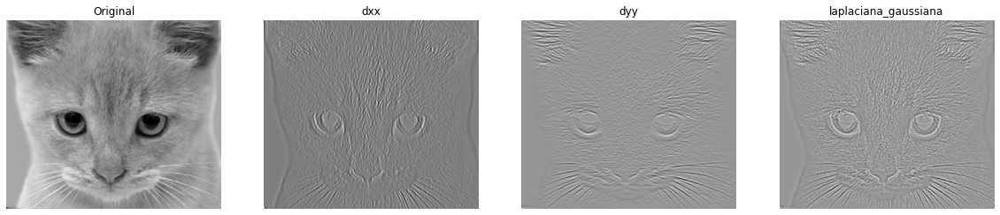

Sigma =  3


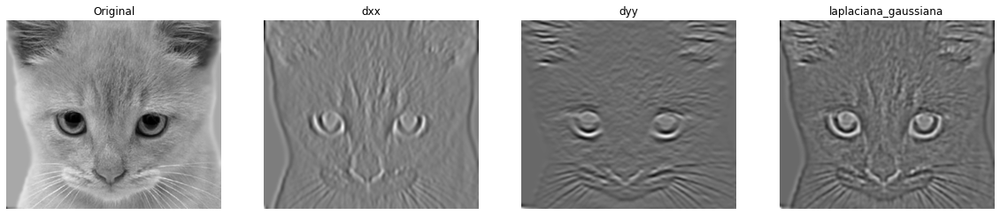

Sigma =  1


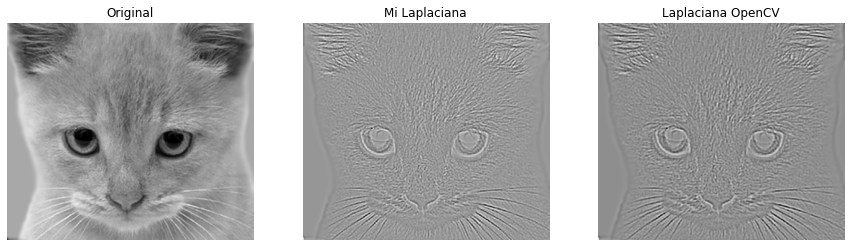

Sigma =  3


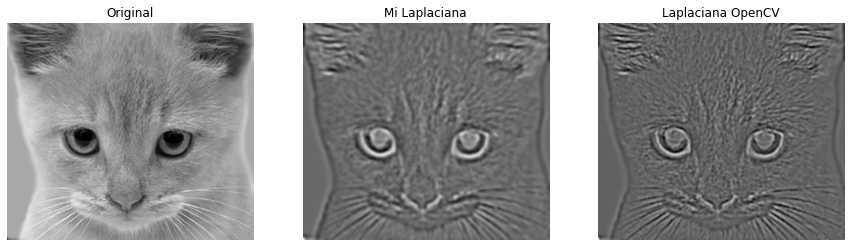

Ahora restamos las laplacianas nuestras y de openCv para compararlas: 


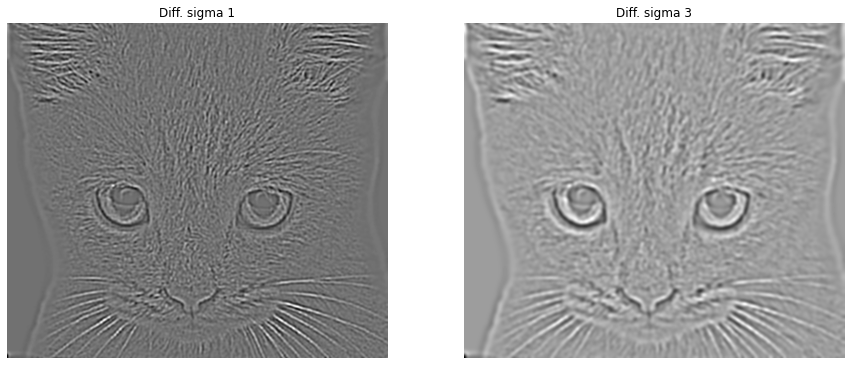

8.758335352295542e+25


In [102]:
# Establecemos parámetros para el experimento
sigma     = [1,3]
modo_padding = "reflejado"

#Leemos la imagen
img = cv.imread("data/cat.bmp",0).astype(np.float64)


#Calculamos la laplaciana implementada por nosotros
vtams = []
milap = []
for i in sigma:
    #Calculamos la laplaciana
    laplaciano, mask_dxx, mask_dyy,tam = laplacian_of_gaussian(img,i)
    milap.append(laplaciano)
    vtams.append(tam)
    print("Sigma = ",i)
    #Mostramos las imagenes
    vim=[img,mask_dxx,mask_dyy,laplaciano]
    titles=["Original","dxx","dyy","laplaciana_gaussiana"]
    show_nimages(vim,titles,ncol=4,figsize=(20,20))

#Calculamos la laplaciana implementada por opencv
#Como queremos comparar, hacemos que el kernel que se use en el calculo de la laplaciana tenga el mismo tamaña
#que el que usamos en nuestra funcion
lap = []
for i in range(len(sigma)):
    lap.append(laplacian(img,vtams[i]))

    
#Visualizamos 
titles = ["Original","Mi Laplaciana","Laplaciana OpenCV"]
for i in range(len(sigma)):
    print("Sigma = ",sigma[i])
    vim = [img,milap[i],lap[i]]
    show_nimages(vim,titles,ncol=3)
    
print("Ahora restamos las laplacianas nuestras y de openCv para compararlas: ")
diff1 = milap[0] - lap[0]
diff3 = milap[1] - lap[1]

titles = ["Diff. sigma 1","Diff. sigma 3"]
show_nimages([diff1,diff3],titles,ncol=2)

print(MSE(lap[1],milap[1]))

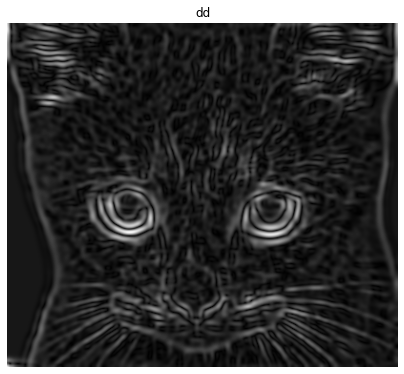

In [103]:
imagen = np.sqrt(mask_dxx*mask_dxx + mask_dyy*mask_dyy)
vim=[imagen]
titles=["dd"]
show_nimages(vim,titles,ncol=1,figsize=(7,7))

# Ejercicio 2

## Ejercicio 2A

In [104]:
"""
    Esta funcion concatena un conjunto de imagenes con una sucesión de dimensión decrecientes para visualizarla en forma de una pirámide
"""

def concatena(vim):
    
    for i in range(len(vim)):
           vim[i] = normalizar(vim[i])
    
    #Obtenemos el máximo de filas y de columnas
    width  = vim[0].shape[1]
    heigth = vim[0].shape[0]
    
    #Redimensionamos las filas y columnas de todas las imagenes
    for i in range(1,len(vim)):
        add_x = width - vim[i].shape[1]
        add_y = heigth - vim[i].shape[0]
        vim[i] = np.pad(vim[i],((0,add_y),(0,0)),mode='constant')
    #Concatenamos horizontalmente
    imc = cv.hconcat(vim) #Para concatenar verticalmente usar vconcat
    
    #Mostramos imágenes
        # plt.figure      --> aumentamos el tamaño de la visualizacion
        # plt.axis('off') --> eliminamos los ejes
        # cv.imwrite      --> para guardar la imagen en un archivo
    plt.figure(figsize=(10,10))
    plt.axis('off')
    plt.imshow(imc[:,:,::-1] if imc.ndim == 3 else imc, cmap='gray')

"""
Funcion que concatena imagenes a color para el BONUS
"""
def concatenaRGB(vim):
    
    for i in range(len(vim)):
           vim[i] = normalizar(vim[i])
    
    #Obtenemos el máximo de filas y de columnas
    width  = vim[0].shape[1]
    heigth = vim[0].shape[0]
    
    
    
    #Redimensionamos las filas y columnas de todas las imagenes y las bandas
    for i in range(1,len(vim)):
        add_x = width - vim[i][:,:,0].shape[1]
        add_y = heigth - vim[i][:,:,0].shape[0]
        r = np.pad(vim[i][:,:,0],((0,add_y),(0,0)),mode='constant')
        g = np.pad(vim[i][:,:,1],((0,add_y),(0,0)),mode='constant')
        b = np.pad(vim[i][:,:,2],((0,add_y),(0,0)),mode='constant')
        r = r[:,:,np.newaxis]
        g = g[:,:,np.newaxis]
        b = b[:,:,np.newaxis]
        vim[i] = np.concatenate((r,g,b),axis=2)
        
    #Concatenamos horizontalmente
    imc = cv.hconcat(vim) #Para concatenar verticalmente usar vconcat
    
    #Mostramos imágenes
        # plt.figure      --> aumentamos el tamaño de la visualizacion
        # plt.axis('off') --> eliminamos los ejes
        # cv.imwrite      --> para guardar la imagen en un archivo
    plt.figure(figsize=(10,10))
    plt.axis('off')
    plt.imshow(imc if imc.ndim == 3 else imc, cmap='gray')
    

In [105]:
"""
    Funcion que resscala una imagen a la mitad de su tamaño
    El reescalado se hace eliminando las filas y las columnas impares
"""
def rescale(imagen,modo_reescalado):
    if modo_reescalado == "v1":
        return imagen[::2,::2]
    elif modo_reescalado == "resize":    
        return cv.resize(imagen,(imagen.shape[1]//2,imagen.shape[0]//2))



"""
    Función que realiza un reescalado reduciendo la dimensión de la imagen a la mitad
    y posteriormente realiza un suavizado de la misma con una maścara gaussiana que depende del 
    sigma que se le pase como parámetro
"""
def suavrescale(imagen,sigma,modo_reescalado,modo_padding):
    suav      = suavizar(imagen,sigma,modo_padding)
    rescalado = rescale(suav,modo_reescalado)
    return rescalado



"""
    Función que dada una imagen construye la pirámide gaussiana suavizando con una máscara gaussianaa
    en funcion del sigma dado como parámetro y de tantos niveles como se indice en el parámetro "lvls"
"""
def piramideGauss(imagen,sigma,lvls,modo_reescalado,modo_padding):
    #Pequeño parche para forzar siempre que se haga eliminando las filas y las columnas pares y así evitar problemas
    modo_reescalado="v1"
    
    ret = [imagen]
    for i in range(1,lvls+1):
        ret.append(suavrescale(ret[i-1],sigma,modo_reescalado,modo_padding))
                                        
    return ret
        

"""
    Funcion que visualiza una pirámide de dos formas distintas
    mode: Gauss ó Laplace
"""
def showPiramide(im_pir,ncol,mode="Gauus",figsize=(12,12)):
    titles = ["Original"]
    lvls = len(im_pir) 
    for i in range(1,lvls):
        titles.append(f"Nivel {i}")
        
    if mode == "Laplace":
        titles = titles[::-1]
        im_pir = im_pir[::-1]
        
    show_nimages(im_pir,titles,ncol=ncol,figsize=figsize)
    if len(im_pir[0].shape) == 2:
        concatena(im_pir)
    else:
        concatenaRGB(im_pir)
"""
Funcion que calcula la pirámide gaussiana de la imagen pasada como parámetro con tantos niveles como índice el argumetno lvls.
Se usa la función de openCV pyrUp
"""
def piramideGauss_cv(imagen,lvls):
    ret = [imagen]
    for i in range(1,lvls+1):
        ret.append(cv.pyrDown(ret[i-1],dstsize=((ret[i-1].shape[1]+1)//2,(ret[i-1].shape[0]+1)//2),borderType=cv.BORDER_REFLECT))
    return ret

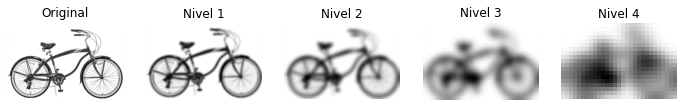

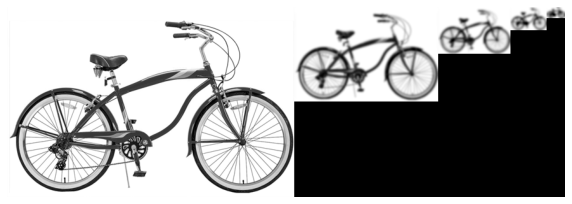

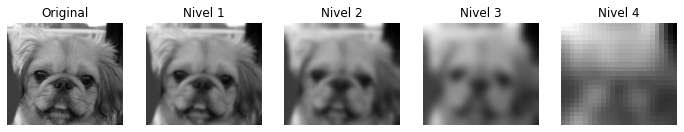

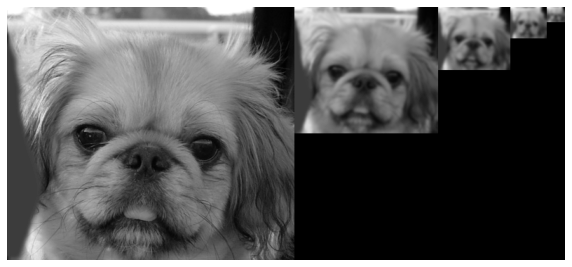

In [106]:
#Elegimos parámetros para el experimento
lvls=4
sigma=3
modo_reescalado = "resize"
modo_padding = "reflejado"

#Leemos la imagen
bici = cv.imread("data/bicycle.bmp",0).astype(np.float64)
perro = cv.imread("data/dog.bmp",0).astype(np.float64)

#Calculamos la pirámide de Gauss
pir1 = piramideGauss(bici,sigma,lvls,modo_reescalado,modo_padding)
pir2 = piramideGauss(perro,sigma,lvls,modo_reescalado,modo_padding)
#Visualizamos la pirámide de Gauss
showPiramide(pir1,ncol=5)
showPiramide(pir2,ncol=5)


El sigma correspondiente al tamaño del kernel 5 es : 0.6666666666666666


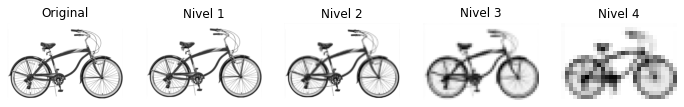

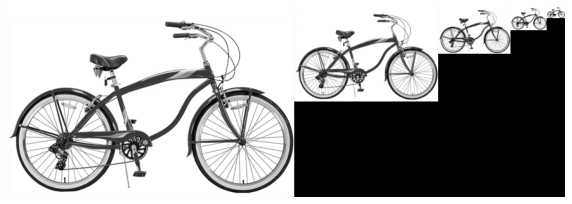

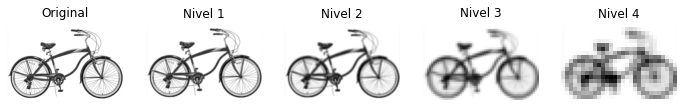

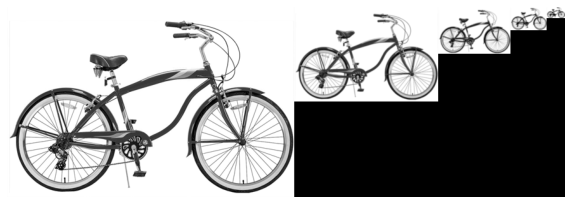

In [107]:
### Acontinuación calculamos la pirámide gaussiana usando las funcione de OpenCV y realizamos una comparacion ajustando nuestros filtros al tamaño del filtro
### que usa por dentro la función pyrDown

#Parámetros por defecto
modo_reescalado = "resize"
modo_padding = "reflejado"
lvls=4

#Tamaño por defecto en el filtro de pyrDown
tam = 5

#Calculamos el sigma a partir del tamaño
sigma = ((5-1)/2)/3.0
print("El sigma correspondiente al tamaño del kernel 5 es :", sigma)
#Calculamos la piramide Gaussiana usando pyrDown
pika = piramideGauss_cv(bici,lvls)

#Calculamos nuestra pirámide Gaussiana ligada a la anterior
pike = piramideGauss(bici,sigma,lvls,modo_reescalado,modo_padding)


#Visualizamos las pirámides
#Nuestra piramide
showPiramide(pike,ncol=5)
#Piramide opencv
showPiramide(pika,ncol=5)



Sigma =  0.1


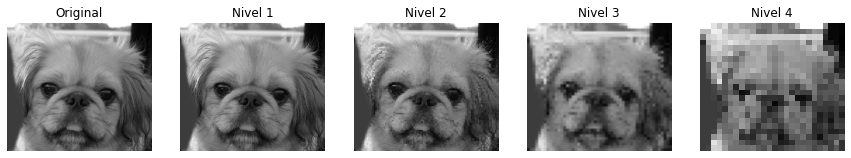

Sigma =  0.5


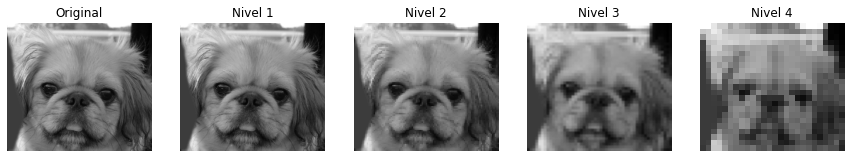

Sigma =  0.8


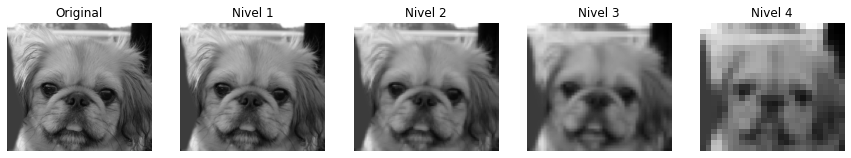

Sigma =  1


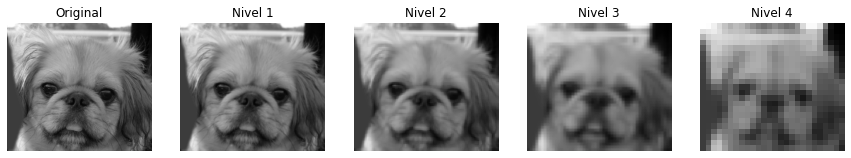

Sigma =  1.3


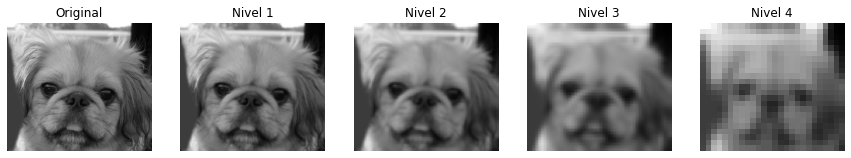

Sigma =  1.7


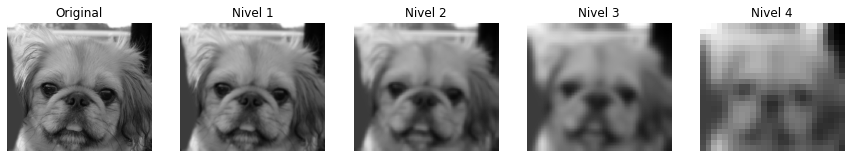

Sigma =  2


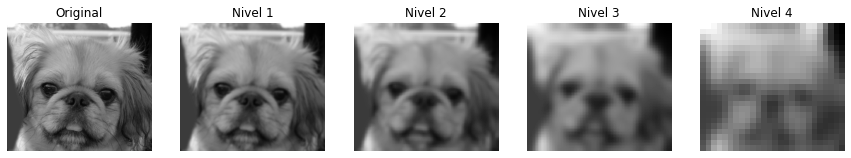

Sigma =  2.5


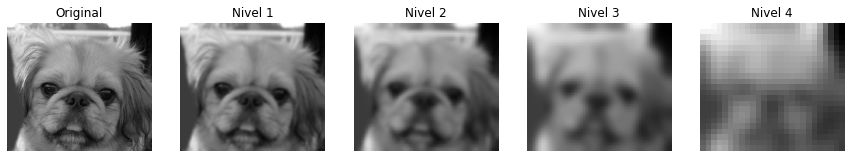

Sigma =  3


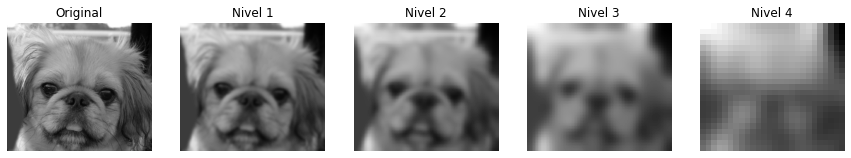

Sigma =  4


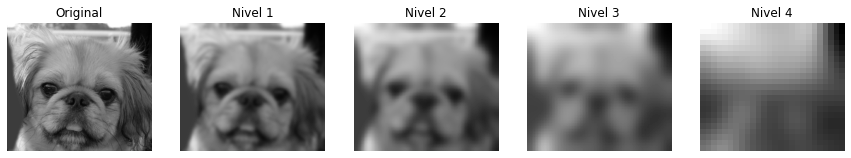

Sigma =  6


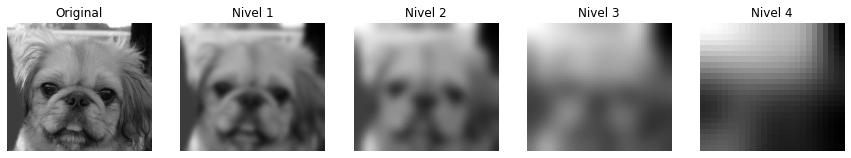

Sigma =  9


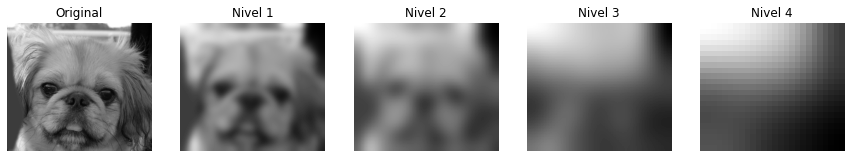

In [108]:
##Finalmente vamos a estudiar el comportamiento de la pirámide para distintos valores de sigma 

#Valores por defecto
modo_reescalado = "resize"
modo_padding = "reflejado"
lvls=4
sigma = [0.1,0.5,0.8,1,1.3,1.7,2,2.5,3,4,6,9]

#Leemos la imagen
perro = cv.imread("data/dog.bmp",0).astype(np.float64)

#Mostramos las distintas piramides por pantalla
titles=["Original", "Nivel 1", "Nivel 2", "Nivel 3", "Nivel 4"]
for i in sigma:
    print("Sigma = ", i)
    pir = piramideGauss(perro,i,lvls,modo_reescalado,modo_padding)
    show_nimages(pir,titles,ncol=5)
    



## Ejercicio 2B

In [109]:
"""
    Funcion que expande la imagen pasada como primer argumento al tamaño de la imagen pasada como segundo argumento
    La interpolación se hace por defecto en modo bilineal
"""

def expand(img_to_expand,img_model,mode_expand):
    
    if mode=="v1":
        negros = np.zeros((img_model.shape[0],img_model.shape[1]))
        negros[::2,::2] = img_to_expand
        return negros
    else:
        return cv.resize(img_to_expand,(img_model.shape[1],img_model.shape[0]))


def suavexpand(img,img_model,sigma,mode_expand,modo_padding):
    rescala = expand(img,img_model,mode_expand)
    suav    = suavizar(rescala,sigma,modo_padding)
    return suav

    
"""
    Funcion que dada una pirámide gaussiana, toma su último nivel y construye una pirámide laplaciana

"""
def piramide_laplaciana(piramide_gaussiana,mode_expand):

    lvls = len(piramide_gaussiana) 
    
    laplaciana=[]
    
    for i in range(lvls-1):
        #Tamaño para redimensionar
        shape = (piramide_gaussiana[i].shape[1],piramide_gaussiana[i].shape[0])
        #expandimos la imagen
        img_exp = cv.resize(piramide_gaussiana[i+1],shape,interpolation=cv.INTER_LINEAR)
        #Calculamos la diferencia y añadimos
        diff = piramide_gaussiana[i] - img_exp
        laplaciana.append(diff)
    #Metemos el último nivel de la gausisiana
    laplaciana.append(piramide_gaussiana[::-1][0])
    
    return laplaciana



def piramide_laplaciana_cv(piramide_gauss):
    piramide_lapl = []
    lvls = len(piramide_gauss) 
    
    for i in range(lvls-1):
        #Tamaño al que tiene que hacer el sampleo
        shape = (piramide_gauss[i].shape[1],piramide_gauss[i].shape[0])
        #Muestreamos para arriba y suavizamos ocn pyrup
        suavexpand = cv.pyrUp(piramide_gauss[i+1],dstsize=shape)
        #Añadimos a la laplaciana
        piramide_lapl.append( piramide_gauss[i] - suavexpand )
    
    piramide_lapl.append(piramide_gauss[::-1][0])
    return piramide_lapl

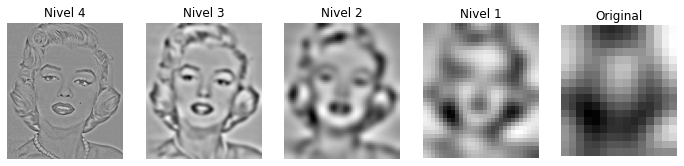

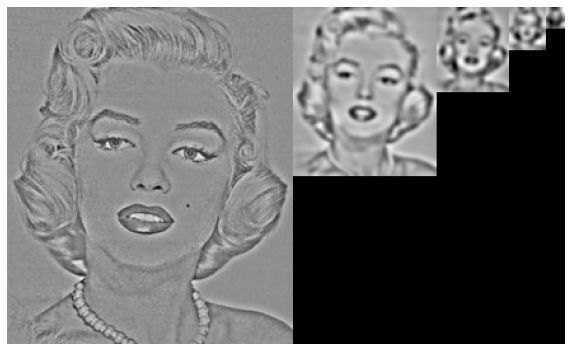

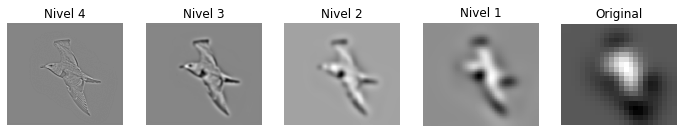

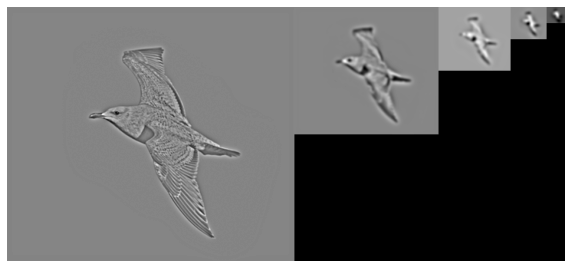

In [110]:
#Parametros para el experimento
sigma = 3
lvls = 4
mode = "v1"
modo_padding="reflejado"

#Leemos la imagen
imagen = cv.imread("data/marilyn.bmp",0).astype(np.float64)
bird = cv.imread("data/bird.bmp",0).astype(np.float64)

#Calculamos la piramide gausiana y la pirámide laplaciana
pir = piramideGauss(imagen,sigma,lvls,mode,modo_padding)
lap = piramide_laplaciana(pir,mode)

pir_bird = piramideGauss(bird,sigma,lvls,mode,modo_padding)
lap_bird = piramide_laplaciana(pir_bird,modo_padding)

#Mostramos la pirámide laplacian
showPiramide(lap[::-1],ncol=5,mode="Laplace")
showPiramide(lap_bird[::-1],ncol=5,mode="Laplace")

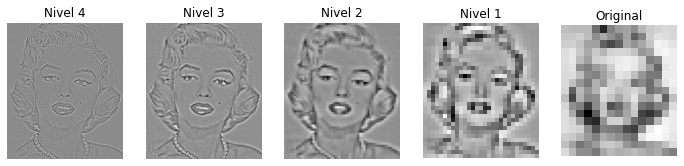

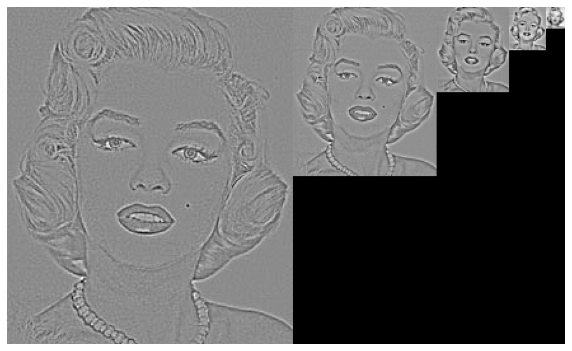

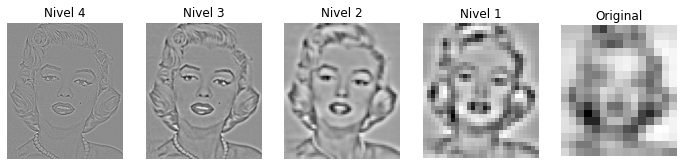

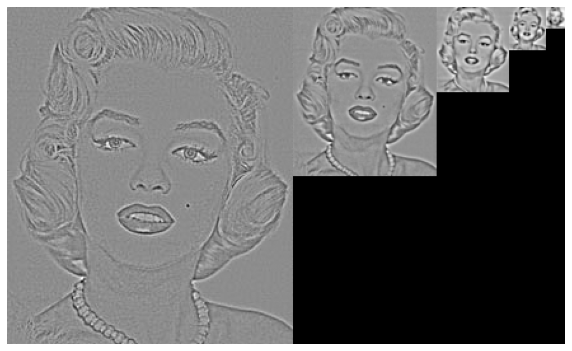

In [111]:
##Probamos la función de la pirámide laplaciana implementada con la función pyrUp de OpenCV

#Parametros para el experimento
sigma = 0.666
lvls = 4
mode = "v1"
modo_padding="reflejado"

#Leemos la imagen
imagen = cv.imread("data/marilyn.bmp",0).astype(np.float64)


#Calculamos la piramide gausiana y la pirámide laplaciana
pir = piramideGauss(imagen,sigma,lvls,mode,modo_padding)
pir_cv = piramideGauss_cv(imagen,lvls)
lap_cv = piramide_laplaciana_cv(pir_cv)
lap = piramide_laplaciana_cv(pir)


#Mostramos la pirámide laplacian
showPiramide(lap[::-1],ncol=5,mode="Laplace")
showPiramide(lap_cv[::-1],ncol=5,mode="Laplace")



Error Cuadrático Medio :  156756.94855861706
Media grises OpenCV:  -0.0009779956105870021
Media grises nuestra implementación:  -0.00988200727413935


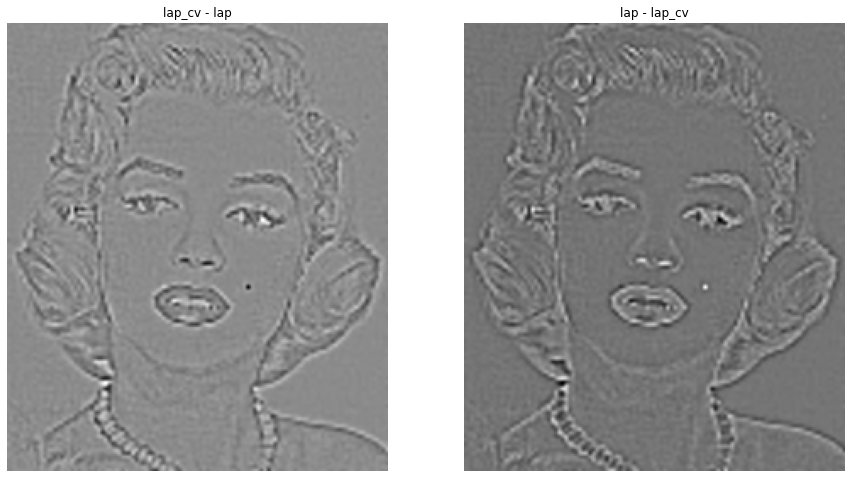

In [112]:
### Aplicamos algunas métricas para ver que las imágenes producidas en el último nivel son distintas
print("Error Cuadrático Medio : ", MSE(lap_cv[0],lap[0]))
print("Media grises OpenCV: ",media_matrix(lap_cv[0]))
print("Media grises nuestra implementación: ",media_matrix(lap[0]))
      
#calculamos la diferencia
diff1 = cv.subtract(lap_cv[0], lap[0])
diff2 = cv.subtract(lap[0], lap_cv[0])
      
show_nimages([diff1,diff2],["lap_cv - lap","lap - lap_cv"],ncol=2)
      
      

Sigma =  0.1


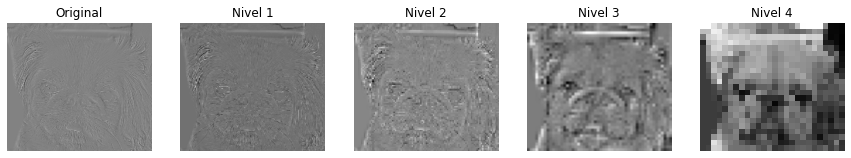

Sigma =  0.5


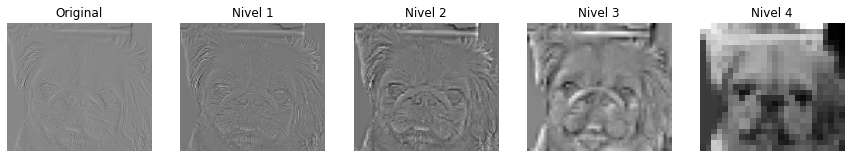

Sigma =  0.8


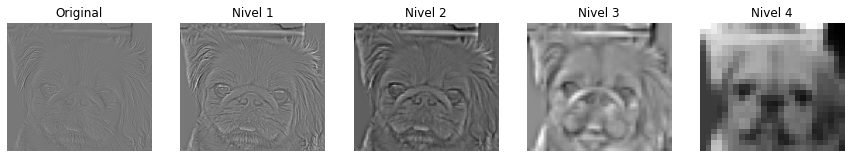

Sigma =  1


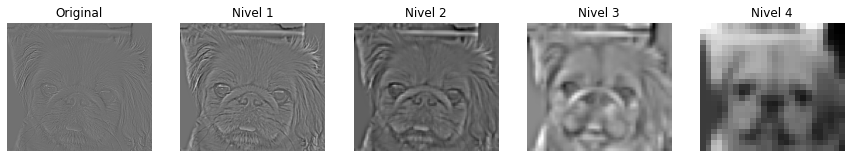

Sigma =  1.3


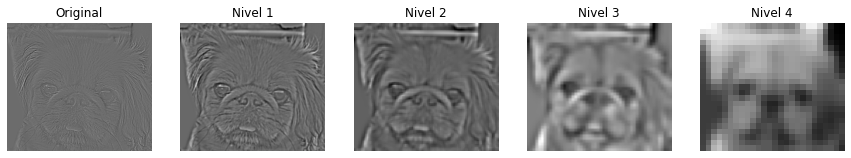

Sigma =  1.7


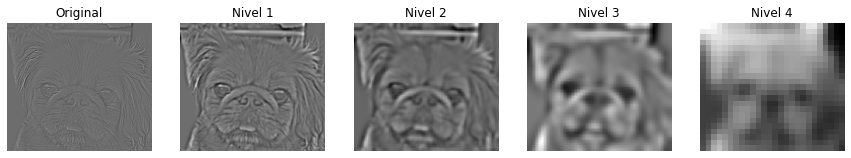

Sigma =  2


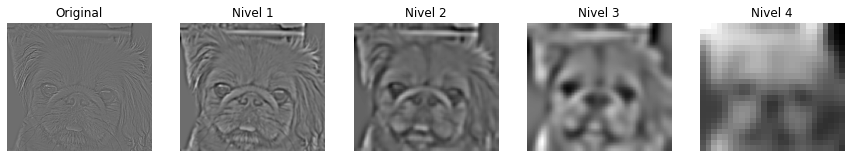

Sigma =  2.5


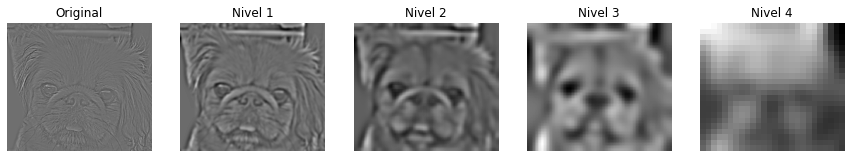

Sigma =  3


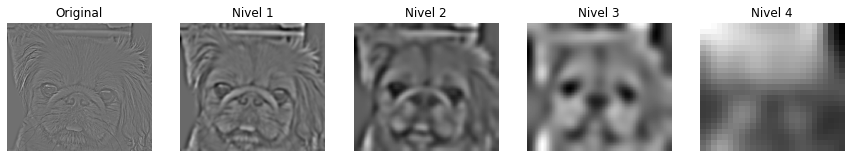

Sigma =  4


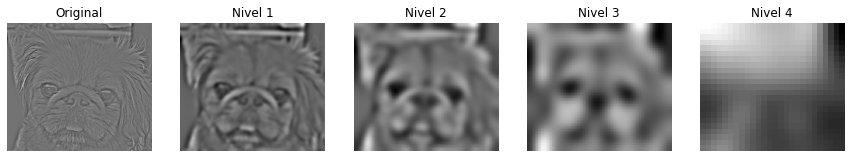

Sigma =  6


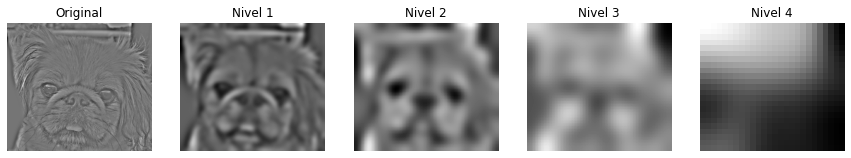

Sigma =  9


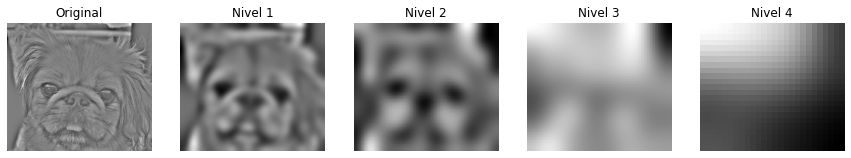

In [113]:
##Finalmente vamos a estudiar el comportamiento de la pirámide para distintos valores de sigma 

#Valores por defecto
modo_reescalado = "resize"
modo_padding = "reflejado"
lvls=4
sigma = [0.1,0.5,0.8,1,1.3,1.7,2,2.5,3,4,6,9]

#Leemos la imagen
perro = cv.imread("data/dog.bmp",0).astype(np.float64)

#Mostramos las distintas piramides por pantalla
titles=["Original", "Nivel 1", "Nivel 2", "Nivel 3", "Nivel 4"]
for i in sigma:
    print("Sigma = ", i)
    pir = piramideGauss(perro,i,lvls,modo_reescalado,modo_padding)
    lap = piramide_laplaciana(pir,mode)
    show_nimages(lap,titles,ncol=5)
    
    
    
   

## Ejercicio 2C

In [114]:
"""
Función para calcular la distancia Euclídea entre dos imágenes
"""
def norma_euclidea(a,b):
    return math.sqrt(np.sum(a-b)**2)

def ejercicio2C():    
    #Imponemos valores por defecto
    sigma = 3
    lvls=4
    mode_ec = "resize"
    modo_padding = "reflejado"

    #Leemos la imagen
    imagen = cv.imread("data/fish.bmp",0).astype(np.float64)

    #Calculamos la piramide gausiana y su laplaciana
    pir = piramideGauss(imagen,sigma,lvls,mode_ec,modo_padding)
    laplaciana = piramide_laplaciana(pir,mode_ec)[::-1]

    #La pirámide laplaciana tiene en su primera posicion el último nivel de la gaussiana
    reconst = [laplaciana[0]]


    #Recorremos la pirámide desde el nivel más alto (i.e. desde la imagen de la gaussiana)
    for i in range(len(laplaciana)-1):
        shape=(laplaciana[i+1].shape[1],laplaciana[i+1].shape[0])
        #Expandimos la imagen del nivel i al tamaño del nivel siguiente
        img = cv.resize(reconst[i],shape,interpolation=cv.INTER_LINEAR)
        #Calculamos la suma 
        suma = img + laplaciana[i+1]
        #suma = normalizar(suma)
        reconst.append(suma)


    #Visualizamos    
    titles = ["1","2","3","4","5"]

    print("Gaussiana: ")
    show_nimages(pir[::-1],titles,ncol=5)
    print("Laplaciana: ")
    show_nimages(laplaciana,titles,ncol=5)
    print("Reconstrucción: ")
    show_nimages(reconst,titles,ncol=5)

    titles=["Último Nivel Gauss","Laplaciana","Original","Reconstrucción"]
    vim = [pir[::-1][0],laplaciana[len(laplaciana)-1],imagen,reconst[len(reconst)-1]]
    show_nimages(vim,titles,ncol=4)



    ## CALCULAMOS LA DISTANCIA EUCLIDEA Y EL MSE PARA COMPROBAR QUE LAS IMAGENES SON IGUALES
    norma = norma_euclidea(imagen,reconst[len(reconst)-1])
    mse = MSE(imagen,reconst[len(reconst)-1])

    print("Norma Euclídea: ", norma)
    print("Error Cuadrático Medio: ", mse)

Gaussiana: 


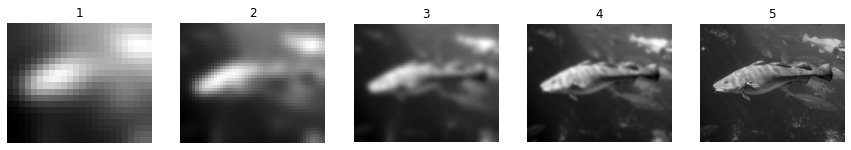

Laplaciana: 


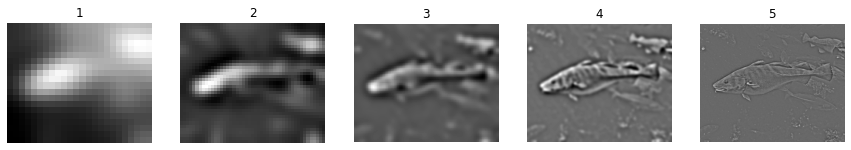

Reconstrucción: 


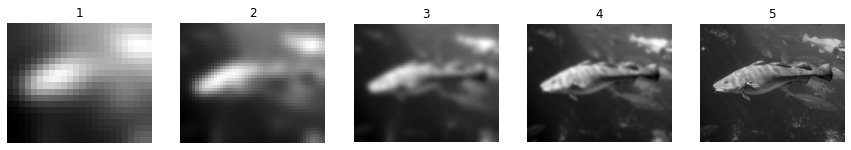

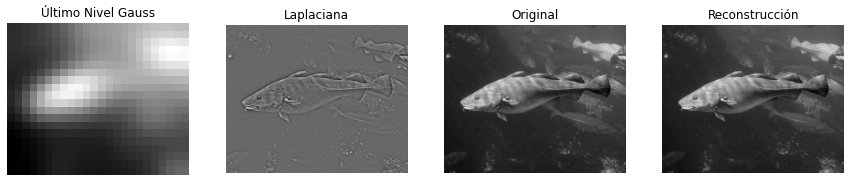

Norma Euclídea:  0.0
Error Cuadrático Medio:  0.0


In [115]:
ejercicio2C()

# Bonus

## Bonus A

In [116]:
"""
Función encargada de realizar la hibridación
    - highimg: la imagen que será de alta frecuencia
    - lowing: la imagen que será de baja frecuencia
    - sighgh: sigma correspondiente a la imagen de alta frecuencia
    - siglow: sigma correspondiente a la imgagen de baja frecuencia
"""
def hibridacion(highimg,lowimg,sighigh,siglow):
    modo_padding ="reflejado"
    #Calculamos la imagen con altas y bajas frecuencias
    img_high = highimg - suavizar(highimg,sighigh,modo_padding)
    img_low  = suavizar(lowimg,siglow,modo_padding)
    #Calculamos la hibridación
    hibry = img_high + img_low
    return hibry, img_high, img_low

In [117]:
def marilenstein_prueba():

    modo_padding = "reflejado"
    #Leemos las imágenes 
    einstein = cv.imread('data/einstein.bmp',0)
    mujer    = cv.imread('data/marilyn.bmp',0)
    
    #Probamos combinación de sigmas 
    lowf   = [5  ,2.5,3,3.5,4  ,4.5,5,5.5,6]
    highf  = [1,0.8,1,1.2,1.5,1.8,2,1.3,0.8]
   
    
    for i in range(len(lowf)):
        #Calculamos las imagenes a bajas y altas frecuencias
        high_einstein = einstein - suavizar(einstein,highf[i],modo_padding)
        low_mujer = suavizar(mujer,lowf[i],modo_padding)
        #Hacemos la hibridación
        marilenstein = high_einstein + low_mujer
        #Visualizamos prueba 
        vim = [high_einstein,low_mujer,marilenstein]
        print("Sigma high: ", highf[i]," - Sigma low: ",lowf[i])
        titles = ["Frecuencia alta","Freuencia Baja","Hibridación"]
        show_nimages(vim,titles,ncol=3,figsize=(8,8))

Sigma high:  1  - Sigma low:  5


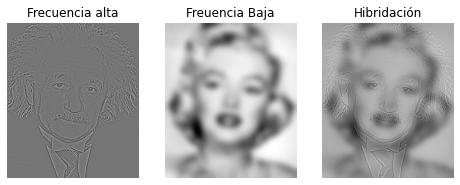

Sigma high:  0.8  - Sigma low:  2.5


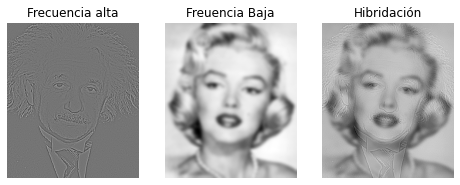

Sigma high:  1  - Sigma low:  3


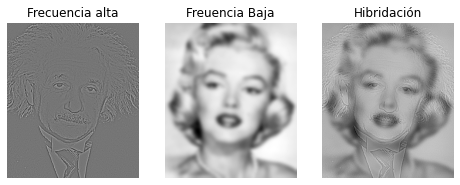

Sigma high:  1.2  - Sigma low:  3.5


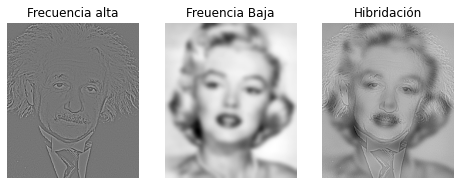

Sigma high:  1.5  - Sigma low:  4


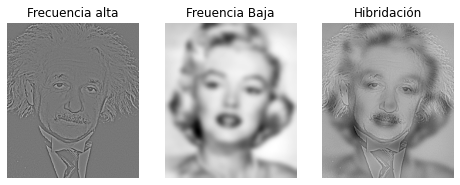

Sigma high:  1.8  - Sigma low:  4.5


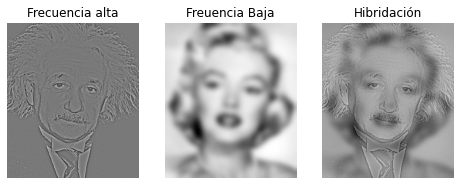

Sigma high:  2  - Sigma low:  5


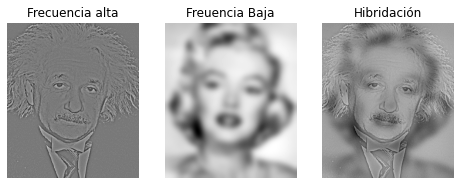

Sigma high:  1.3  - Sigma low:  5.5


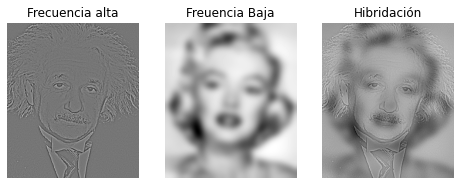

Sigma high:  0.8  - Sigma low:  6


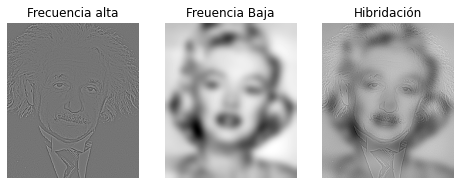

In [118]:
marilenstein_prueba()

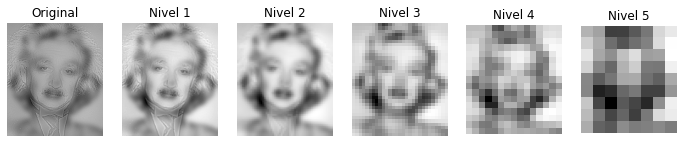

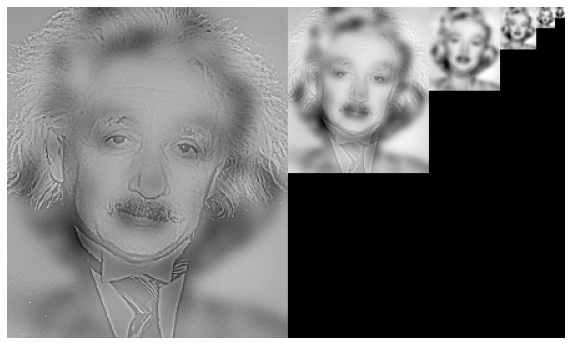

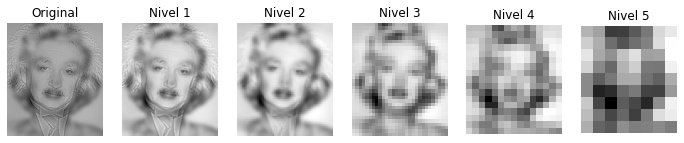

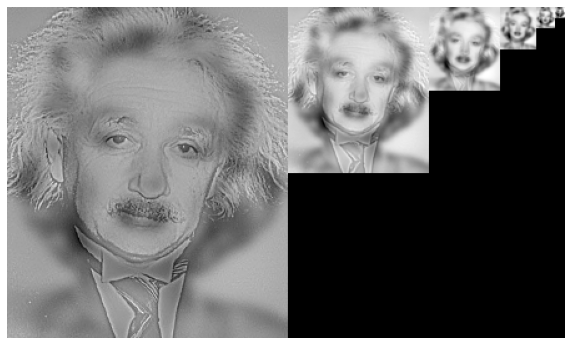

In [119]:
#Seleccionamos los sigmas que mejor realizan la hibridación

einstein = cv.imread('data/einstein.bmp',0)
mujer    = cv.imread('data/marilyn.bmp',0)

high = [1.3,1.8]
low  = [5.5,4.5]

for i in range(len(low)):
    high_einstein = einstein - suavizar(einstein,high[i],modo_padding)
    low_mujer = suavizar(mujer,low[i],modo_padding)
    marilenstein = high_einstein + low_mujer 
    pir = piramideGauss(marilenstein,sigma=1,lvls=5,modo_reescalado="v1",modo_padding="reflejado")
    showPiramide(pir,ncol=6)

In [120]:
"""
Hibridación párajo y avión
"""
def pajavion():
    #Probamos sigmas pra las frecuencias
    highf = (2.5, 9, 3.1)
    lowf = (7.0, 3.5, 3.5)
    
    modo_padding="reflejado"
    #Leemos las imágenes
    himg = cv.imread('data/bird.bmp', 0)
    limg = cv.imread('data/plane.bmp', 0)
  
    vhibri = []
    for hsig, lsig in zip(highf, lowf):
        #Calculamos las hibridaciones junto con las imágenes que la conforman
        hibry, high, low = hibridacion(himg, limg, hsig, lsig)
        #Visualizamos
        vim = [high,low,hibry]
        print("Sigma high: ", hsig," - Sigma low: ",lsig)
        titles = ["Alta frecuencia","Baja Frecuencia","Original"]
        show_nimages(vim,titles,ncol=3)
        #Añadimos al vector de hibridación
        vhibri.append(hibry)
        
    #Mostramos pirámide
    for i in range(len(vhibri)):
        pir = piramideGauss(vhibri[i],sigma=1,lvls=5,modo_reescalado="v1",modo_padding="reflejado")
        showPiramide(pir,ncol=6)
        



Sigma high:  2.5  - Sigma low:  7.0


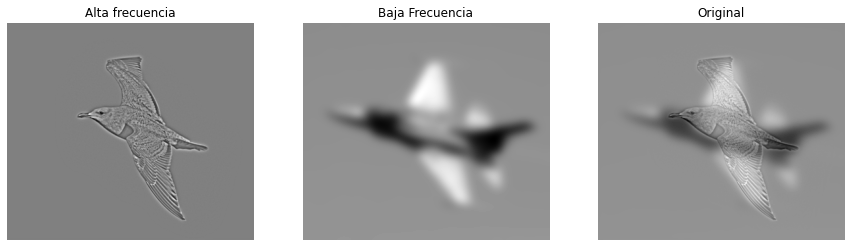

Sigma high:  9  - Sigma low:  3.5


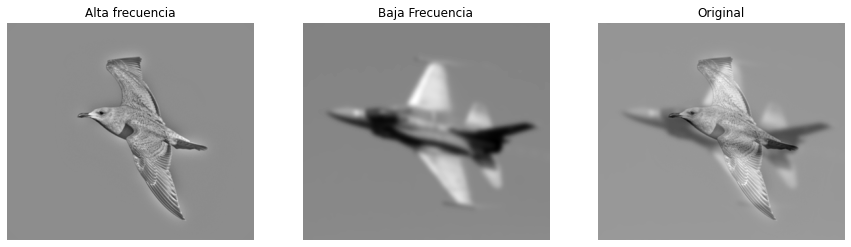

Sigma high:  3.1  - Sigma low:  3.5


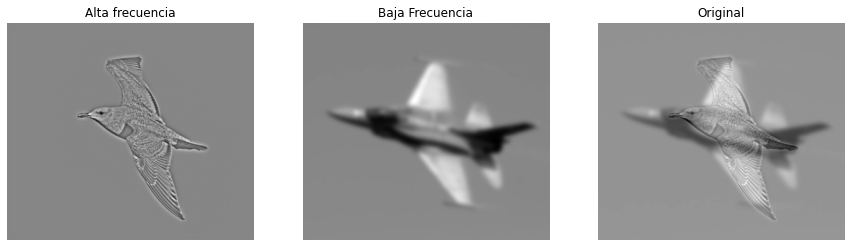

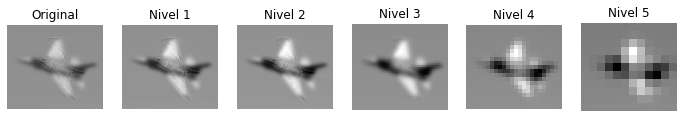

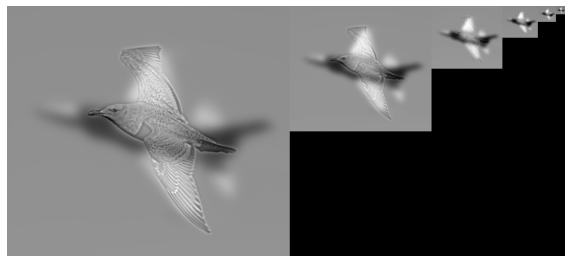

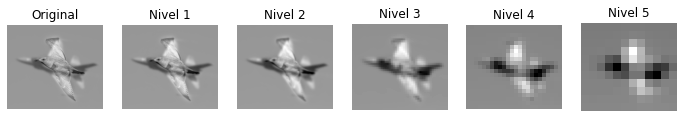

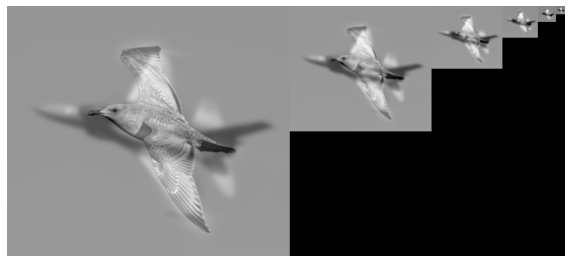

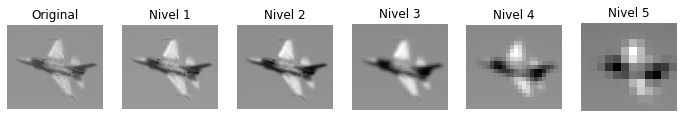

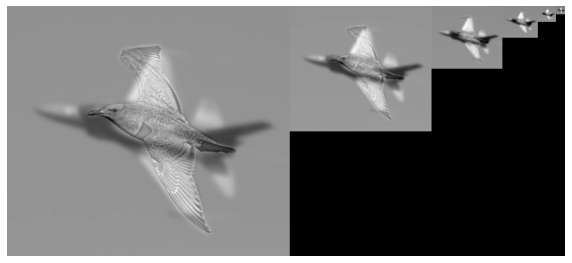

In [121]:
pajavion()

In [122]:
def subperino():
    #Elegimos los sigmas de los experimentos y fijamos el modo de padding
    hsig = (1.6, 0.8, 2.3)
    lsig = (5, 6.5, 7.0)
    modo_padding="reflejado"
    
    #Leemos las imágenes
    himg = cv.imread('data/fish.bmp', 0)
    limg = cv.imread('data/submarine.bmp', 0)
  
    vhibri = []
    for hs, ls in zip(hsig, lsig):
        #Calculamos hibridación e imágenes con frecuencias bajas y altas
        hibry, high, low = hibridacion(himg, limg, hs, ls)
        #Visualizacion
        vim = [high,low,hibry]
        print("Sigma high: ", hs," - Sigma low: ",ls)
        titles = ["Alta frecuencia","Baja Frecuencia","Hibridación"]
        show_nimages(vim,titles,ncol=3)
        #Añadimos al vector de hibridaciones
        vhibri.append(hibry)
    #Mostramos pirámies
    for i in range(len(vhibri)):
        pir = piramideGauss(vhibri[i],sigma=1,lvls=5,modo_reescalado="v1",modo_padding="reflejado")
        showPiramide(pir,ncol=6)

Sigma high:  1.6  - Sigma low:  5


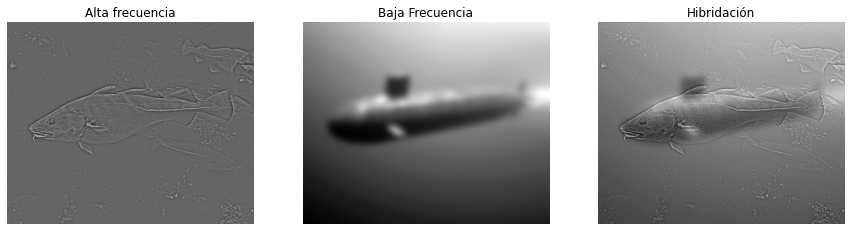

Sigma high:  0.8  - Sigma low:  6.5


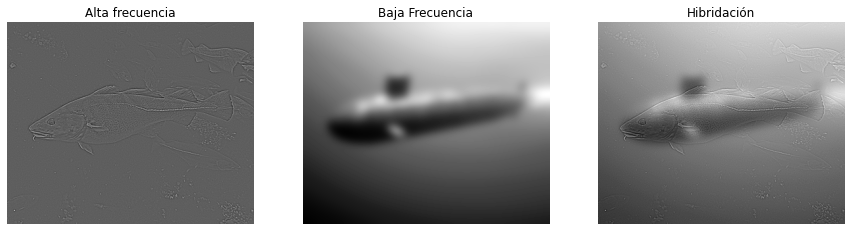

Sigma high:  2.3  - Sigma low:  7.0


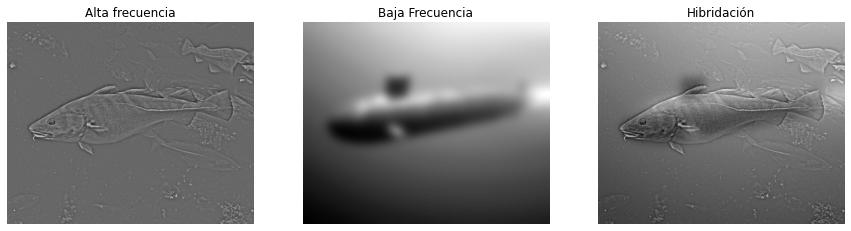

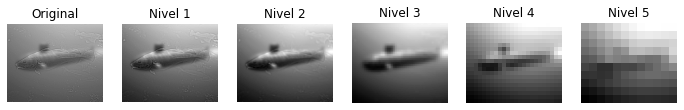

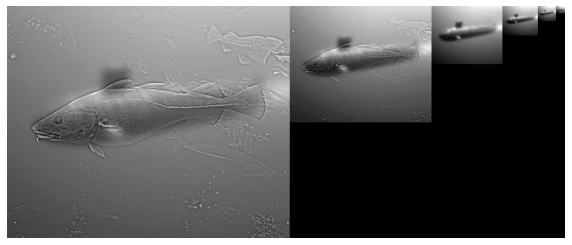

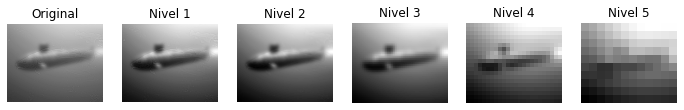

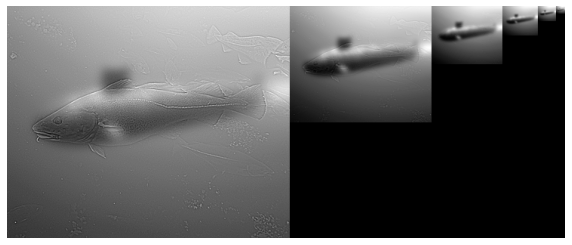

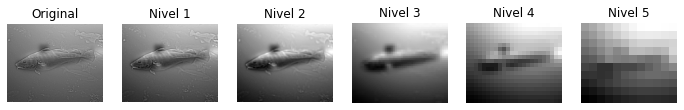

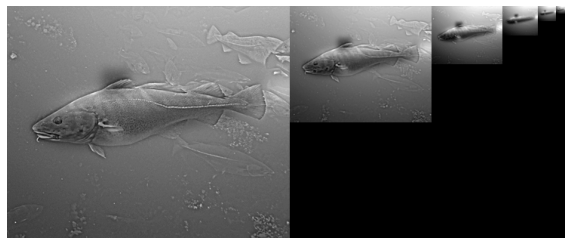

In [123]:
subperino()

In [124]:
def perrigato():
    #Indicamos valores para la freucencias altas y bajas y adjutamos el modo de padding
    hsig = (3, 4.5 ,6)
    lsig = (9, 8 , 10)
    modo_padding="reflejado"
    
    #Leemos las imágenes
    himg = cv.imread('data/dog.bmp', 0)
    limg = cv.imread('data/cat.bmp', 0)
  
    #Realizamos las distintas hibridaciones y visualizamos
    vhibri = []
    for hsi, lsi in zip(hsig, lsig):
        hibry, high, low = hibridacion(himg, limg, hsi, lsi)
        print("Sigma high: ", hsi," - Sigma low: ",lsi)
        vim = [high,low,hibry]
        titles = ["Alta frecuencia","Baja Frecuencia","Hibridación"]
        show_nimages(vim,titles,ncol=3)
        vhibri.append(hibry)
        
    #Visualizamos la pirámide Gaussiana
    for i in range(len(vhibri)):
        pir = piramideGauss(vhibri[i],sigma=1,lvls=5,modo_reescalado="v1",modo_padding="reflejado")
        showPiramide(pir,ncol=6)

Sigma high:  3  - Sigma low:  9


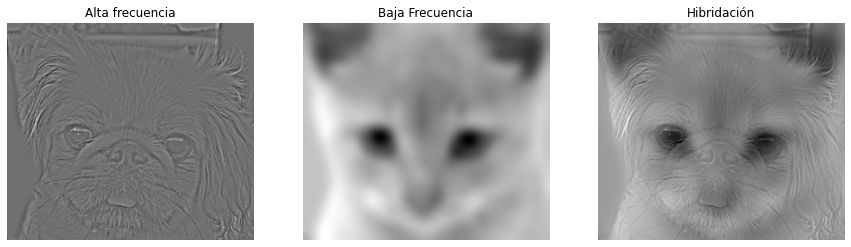

Sigma high:  4.5  - Sigma low:  8


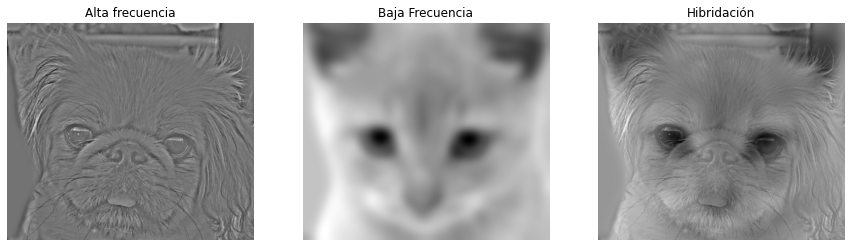

Sigma high:  6  - Sigma low:  10


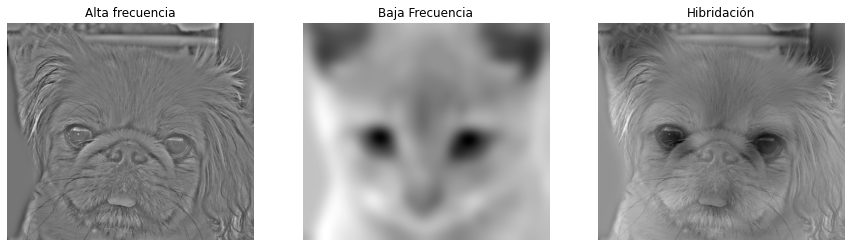

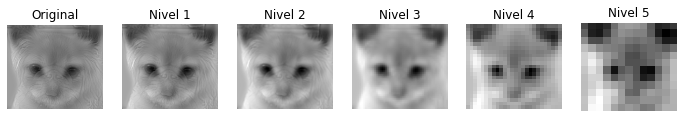

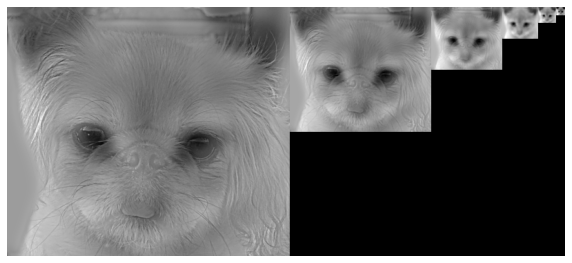

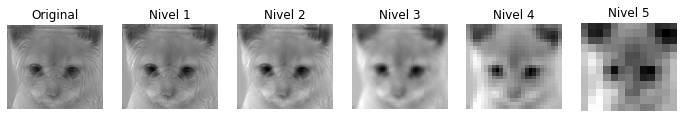

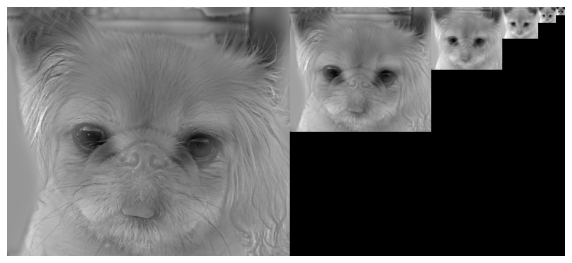

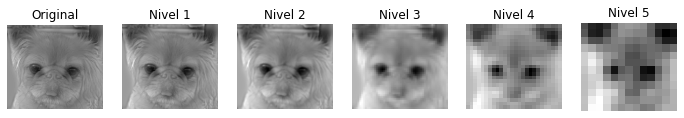

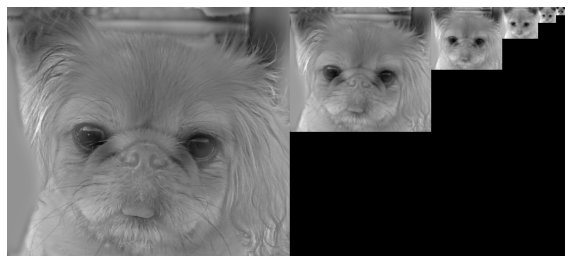

In [125]:
perrigato()

In [126]:
def bicimoto():
    #Valores por defecto
    hsig = (1.8, 1.3 , 2.8, 3.5 )
    lsig = (5, 4.5  , 6  , 6)
    modo_padding="reflejado"
    
    #Lectura de imagenes
    himg = cv.imread('data/bicycle.bmp', 0)
    limg = cv.imread('data/motorcycle.bmp', 0)

    vhibri = []
    for hsi, lsi in zip(hsig, lsig):
        #Hibridacion
        hibry, high, low = hibridacion(himg, limg, hsi, lsi)
        #Visualizacion
        vim = [high,low,hibry]
        print("Sigma high: ", hsi," - Sigma low: ",lsi)
        titles = ["Alta frecuencia","Baja Frecuencia","Hibridación"]
        show_nimages(vim,titles,ncol=3)
        vhibri.append(hibry)
    #Visualizacion
    for i in range(len(vhibri)):
        pir = piramideGauss(vhibri[i],sigma=1,lvls=5,modo_reescalado="v1",modo_padding="reflejado")
        showPiramide(pir,ncol=6)

Sigma high:  1.8  - Sigma low:  5


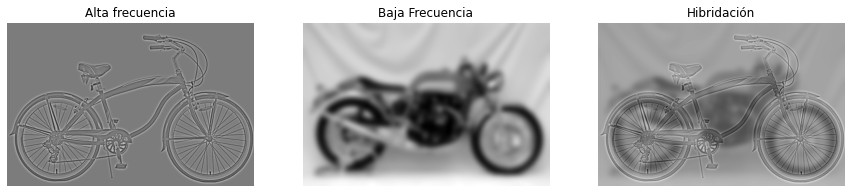

Sigma high:  1.3  - Sigma low:  4.5


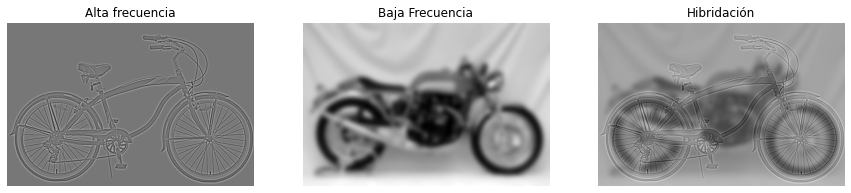

Sigma high:  2.8  - Sigma low:  6


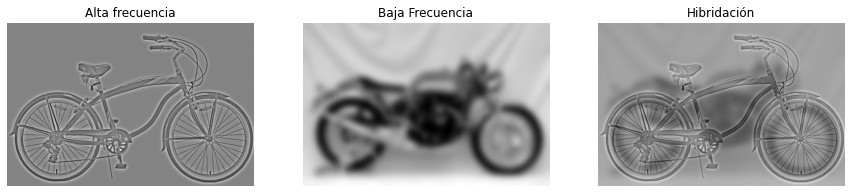

Sigma high:  3.5  - Sigma low:  6


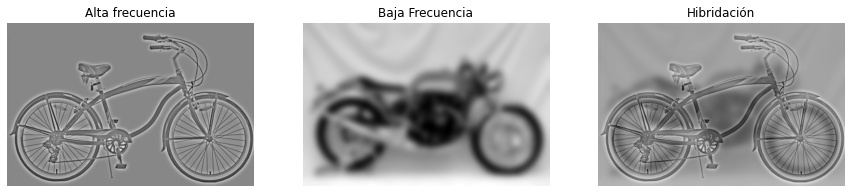

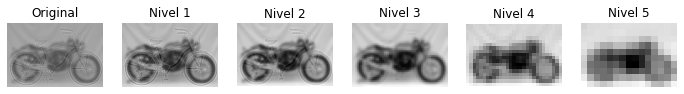

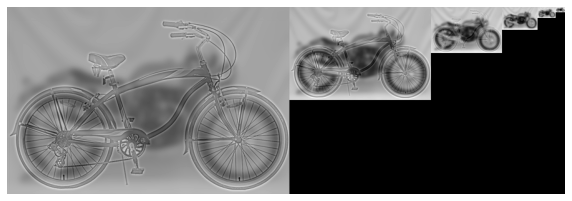

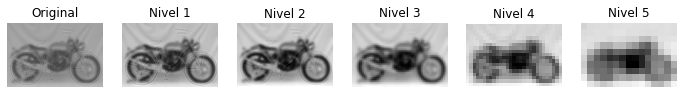

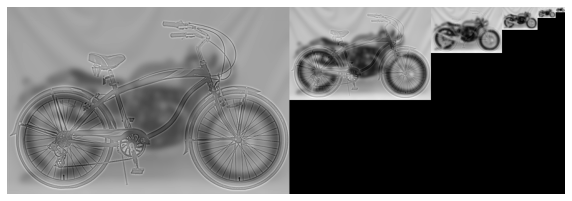

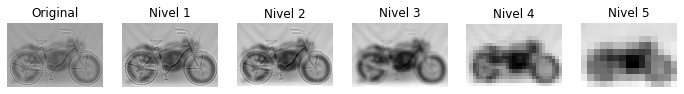

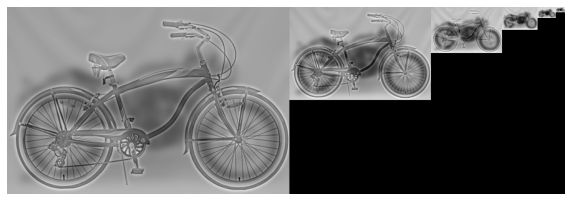

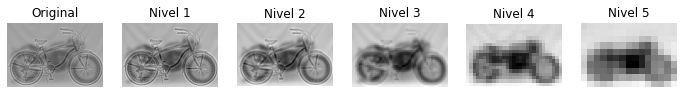

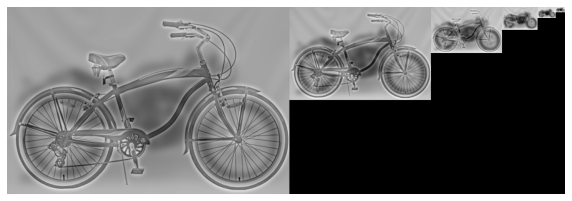

In [127]:
bicimoto()

## Bonus B

In [128]:
## La implementacino de las funciones siguen este proceso
# 1) Lectura de sigmas y de las imagenes
# 2) Hibridacion
# 3) Visualización

In [129]:
def perrigato_color():
    hsig = (3, 10 ,6)
    lsig = (9, 10 , 10)
    modo_padding="reflejado"
    himg = cv.imread('data/dog.bmp', 1)[:,:,::-1]
    limg = cv.imread('data/cat.bmp', 1)[:,:,::-1]

    vhibri = []
    for hsi, lsi in zip(hsig, lsig):
        hibry, high, low = hibridacion(himg, limg, hsi, lsi)
        vim = [high,low,hibry]
        print("Sigma high: ", hsi," - Sigma low: ",lsi)
        titles = ["Alta frecuencia","Baja Frecuencia","Hibridación"]
        show_nimages(vim,titles,ncol=3)
        vhibri.append(hibry)
        
    for i in range(len(vhibri)):
        pir = piramideGauss(vhibri[i],sigma=1,lvls=5,modo_reescalado="v1",modo_padding="reflejado")
        showPiramide(pir,ncol=6)

Sigma high:  3  - Sigma low:  9


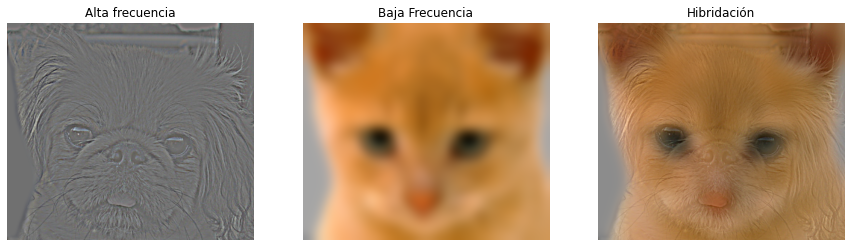

Sigma high:  10  - Sigma low:  10


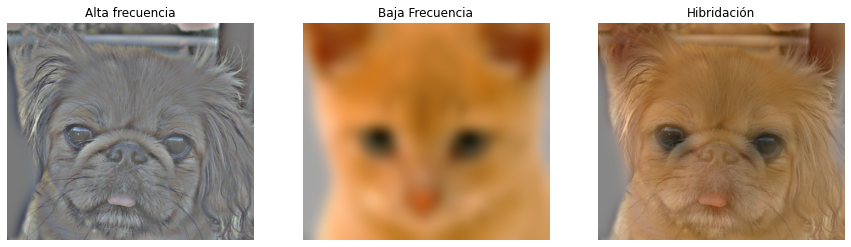

Sigma high:  6  - Sigma low:  10


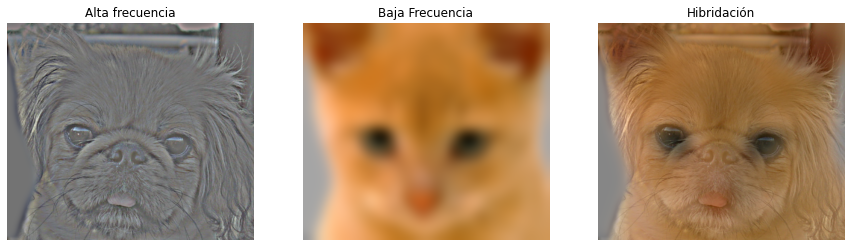

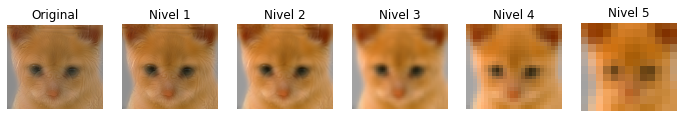

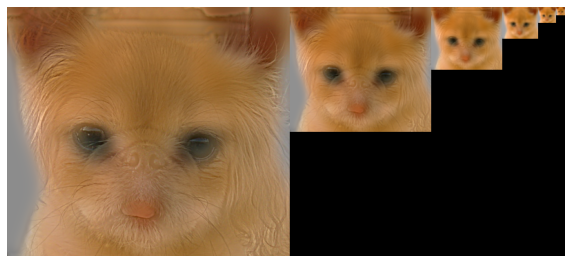

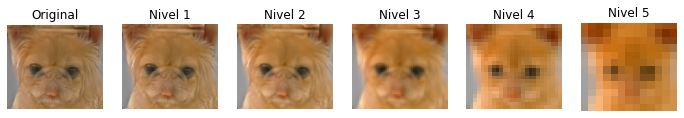

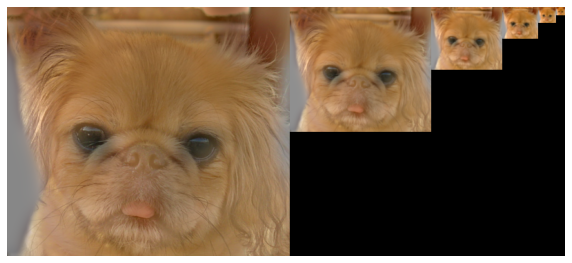

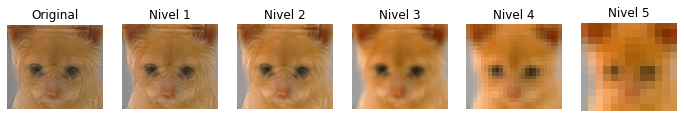

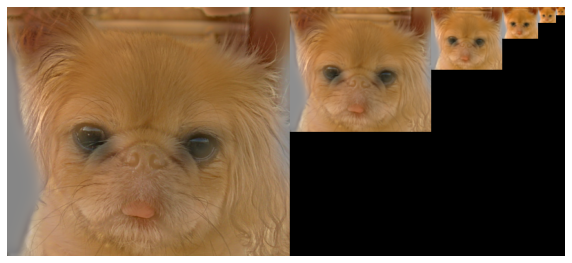

In [130]:
perrigato_color()

In [131]:
def subperino_color():
    hsig = (1.3, 2.8, 2)
    lsig = (5  , 6.5, 4.0)
    modo_padding="reflejado"
    himg = cv.imread('data/fish.bmp', 1)[:,:,::-1]
    limg = cv.imread('data/submarine.bmp', 1)[:,:,::-1]

    vhibri = []
    for hsi, lsi in zip(hsig, lsig):
        hibry, high, low = hibridacion(himg, limg, hsi, lsi)
        vim = [high,low,hibry]
        print("Sigma high: ", hsi," - Sigma low: ",lsi)
        titles = ["Alta frecuencia","Baja Frecuencia","Hibridación"]
        show_nimages(vim,titles,ncol=3)
        vhibri.append(hibry)
        
    for i in range(len(vhibri)):
        pir = piramideGauss(vhibri[i],sigma=1,lvls=5,modo_reescalado="v1",modo_padding="reflejado")
        showPiramide(pir,ncol=6)

Sigma high:  1.3  - Sigma low:  5


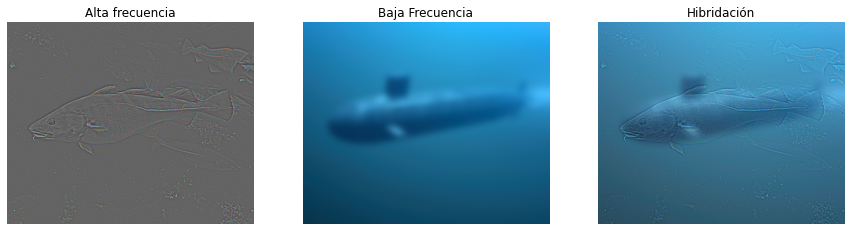

Sigma high:  2.8  - Sigma low:  6.5


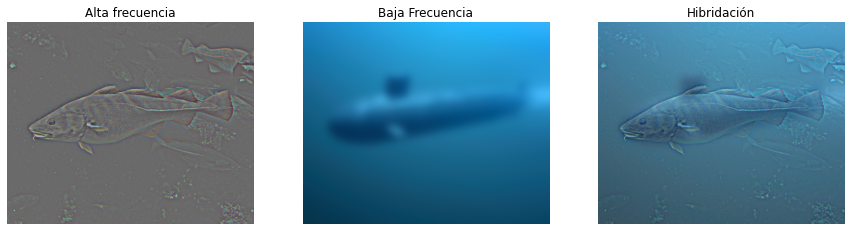

Sigma high:  2  - Sigma low:  4.0


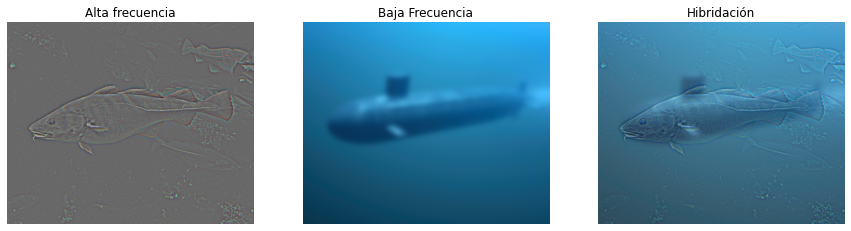

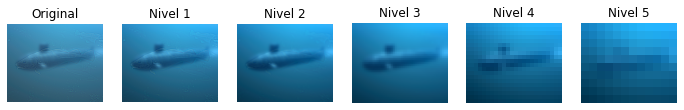

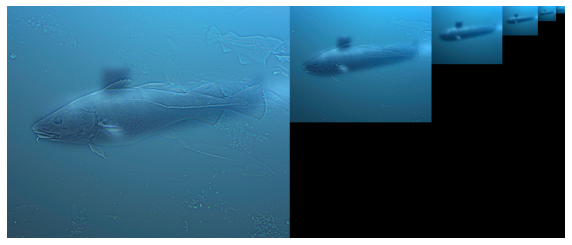

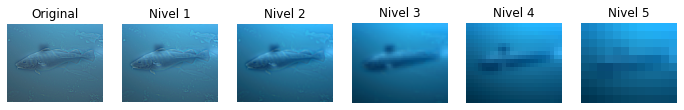

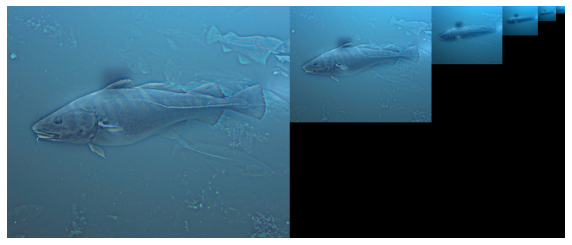

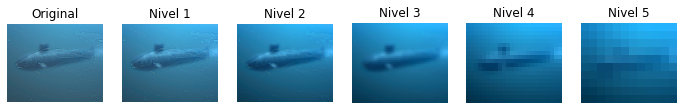

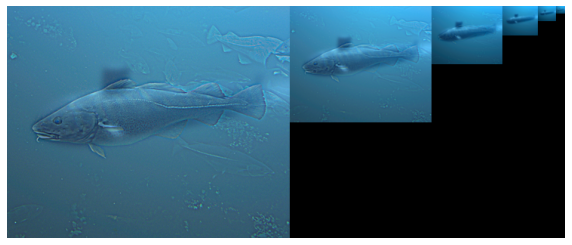

In [132]:
subperino_color()

In [133]:
def pajavion_color():
    hsig = (1.3, 3,   4.5 ,8.5)
    lsig = (5  , 6.5, 7.0 ,6)
    modo_padding="reflejado"
    himg = cv.imread('data/bird.bmp', 1)[:,:,::-1]
    limg = cv.imread('data/plane.bmp', 1)[:,:,::-1]

    vhibri = []
    for hsi, lsi in zip(hsig, lsig):
        hibry, high, low = hibridacion(himg, limg, hsi, lsi)
        vim = [high,low,hibry]
        print("Sigma high: ", hsi," - Sigma low: ",lsi)
        titles = ["Alta frecuencia","Baja Frecuencia","Hibridación"]
        show_nimages(vim,titles,ncol=3)
        vhibri.append(hibry)
        
    for i in range(len(vhibri)):
        pir = piramideGauss(vhibri[i],sigma=1,lvls=5,modo_reescalado="v1",modo_padding="reflejado")
        showPiramide(pir,ncol=6)

Sigma high:  1.3  - Sigma low:  5


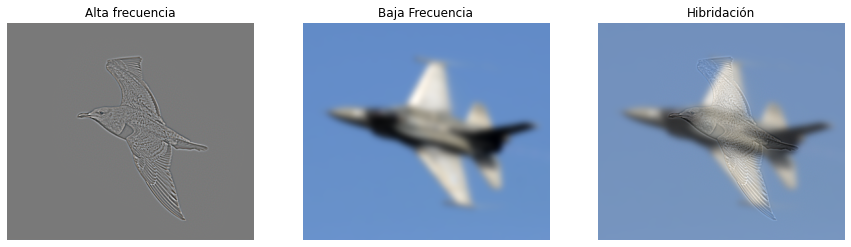

Sigma high:  3  - Sigma low:  6.5


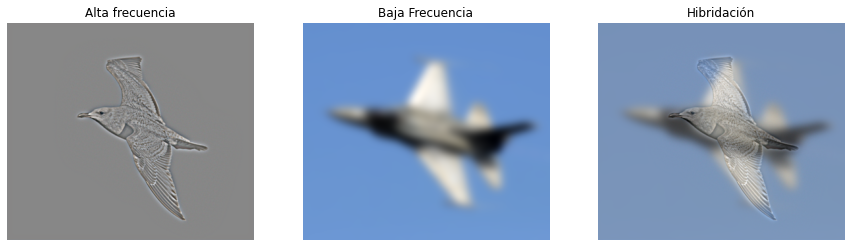

Sigma high:  4.5  - Sigma low:  7.0


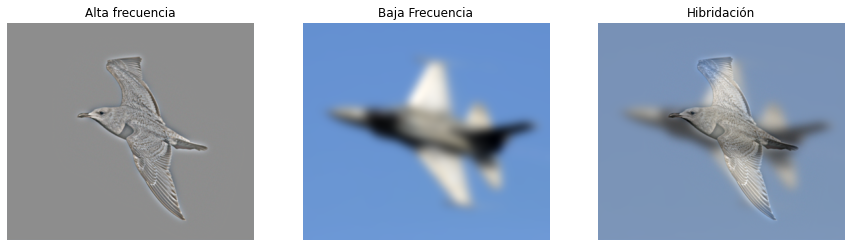

Sigma high:  8.5  - Sigma low:  6


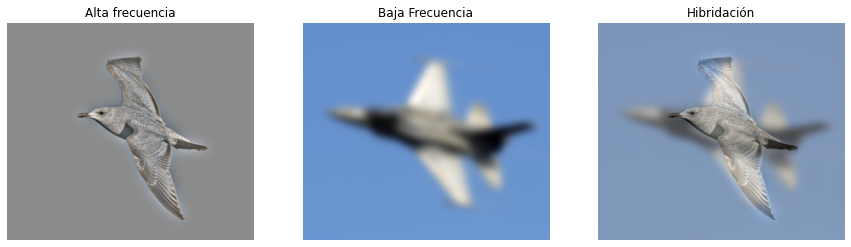

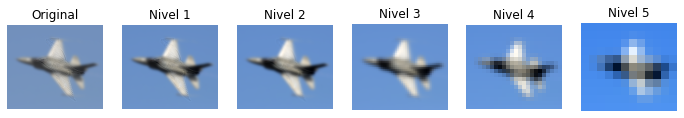

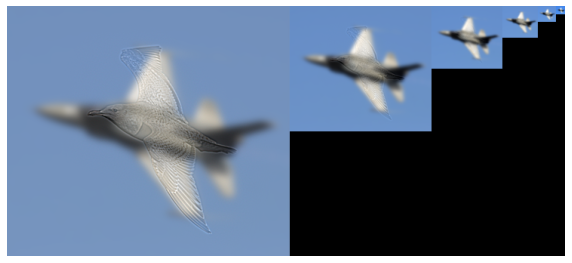

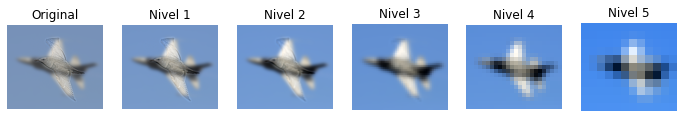

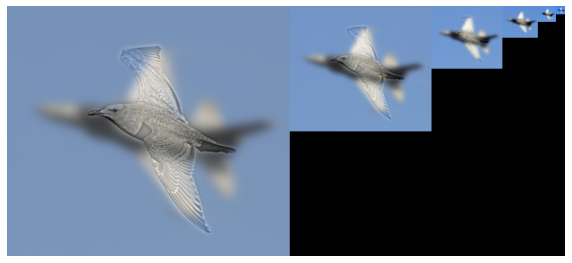

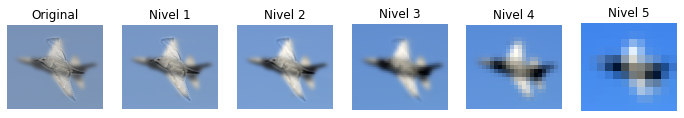

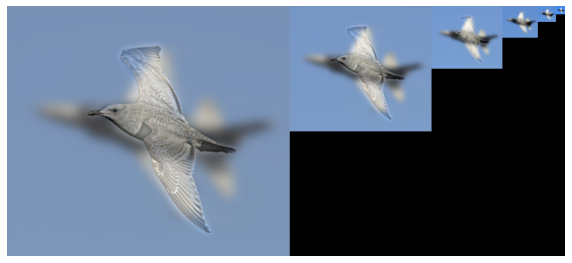

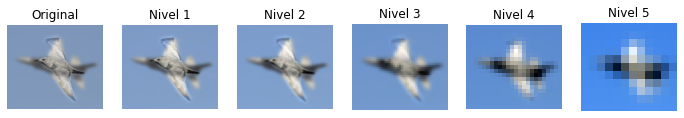

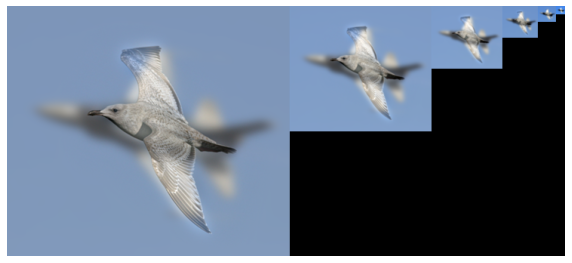

In [134]:
pajavion_color()

In [135]:
def bicimoto_color():
    high = (1 , 1.3  ,1.5,  3.1)
    low = (7 , 5.5   ,4.4,    5)
    modo_padding="reflejado"
    himg = cv.imread('data/bicycle.bmp', 1)[:,:,::-1]
    limg = cv.imread('data/motorcycle.bmp', 1)[:,:,::-1]

    vhibri = []
    for hsi, lsi in zip(high, low):
        hibry, high, low = hibridacion(himg, limg, hsi, lsi)
        print("Sigma high: ", hsi," - Sigma low: ",lsi)
        vim = [high,low,hibry]
        titles = ["Alta frecuencia","Baja Frecuencia","Hibridación"]
        show_nimages(vim,titles,ncol=3)
        vhibri.append(hibry)
        
    for i in range(len(vhibri)):
        pir = piramideGauss(vhibri[i],sigma=1,lvls=5,modo_reescalado="v1",modo_padding="reflejado")
        showPiramide(pir,ncol=6)

Sigma high:  1  - Sigma low:  7


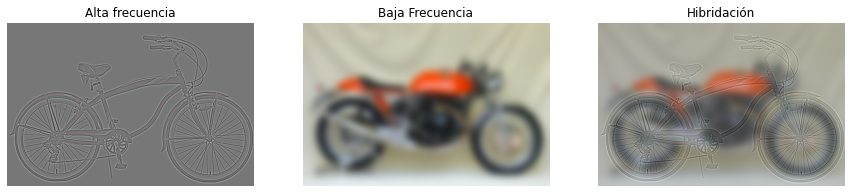

Sigma high:  1.3  - Sigma low:  5.5


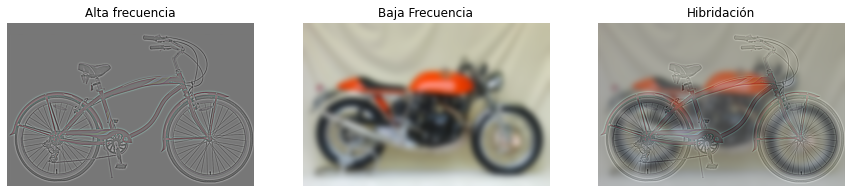

Sigma high:  1.5  - Sigma low:  4.4


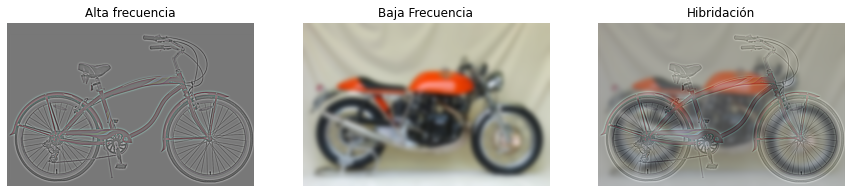

Sigma high:  3.1  - Sigma low:  5


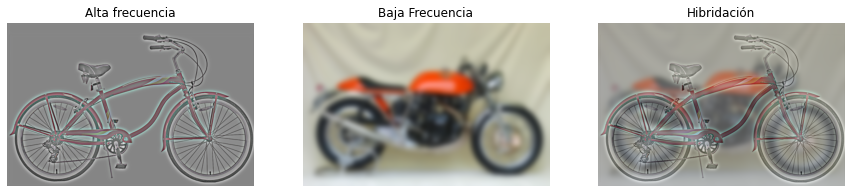

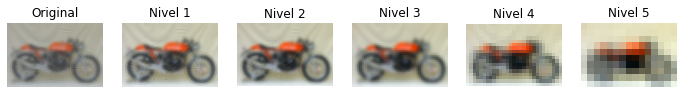

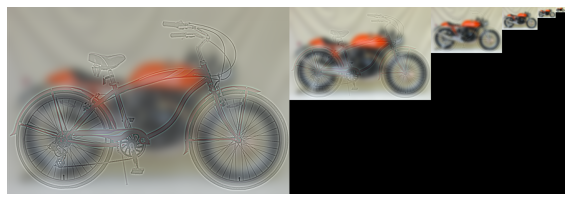

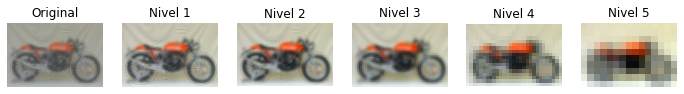

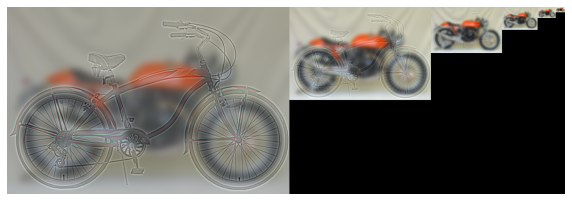

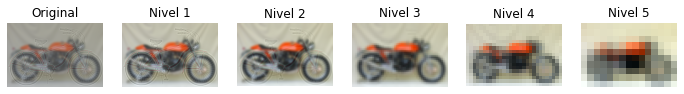

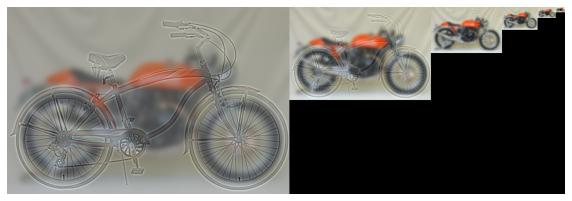

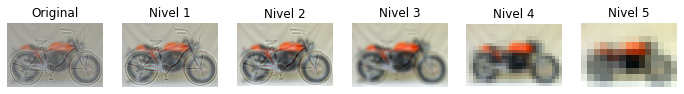

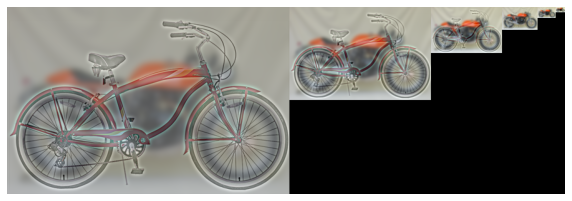

In [136]:
bicimoto_color()

In [137]:
def marilenstein_color():
    highf   = [2 ,1.8, 1.4  ,3]
    lowf  = [5   ,3  , 5   ,5.5]
    modo_padding="reflejado"
    
    himg = cv.imread('data/einstein.bmp', 1)[:,:,::-1]
    limg = cv.imread('data/marilyn.bmp', 1)[:,:,::-1]
    vhibri = []
    for hsi, lsi in zip(highf,lowf):
        hibry, high, low = hibridacion(himg, limg, hsi, lsi)
        print("Sigma high: ", hsi," - Sigma low: ",lsi)
        vim = [high,low,hibry]
        titles = ["Alta frecuencia","Baja Frecuencia","Hibridación"]
        show_nimages(vim,titles,ncol=3)
        vhibri.append(hibry)
        
    for i in range(len(vhibri)):
        pir = piramideGauss(vhibri[i],sigma=1,lvls=5,modo_reescalado="v1",modo_padding="reflejado")
        showPiramide(pir,ncol=6)

Sigma high:  2  - Sigma low:  5


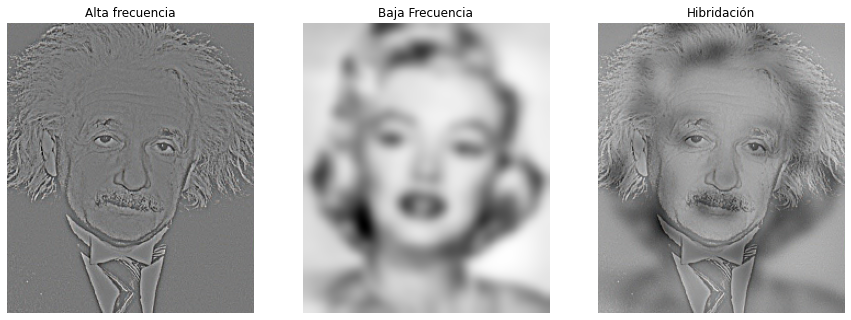

Sigma high:  1.8  - Sigma low:  3


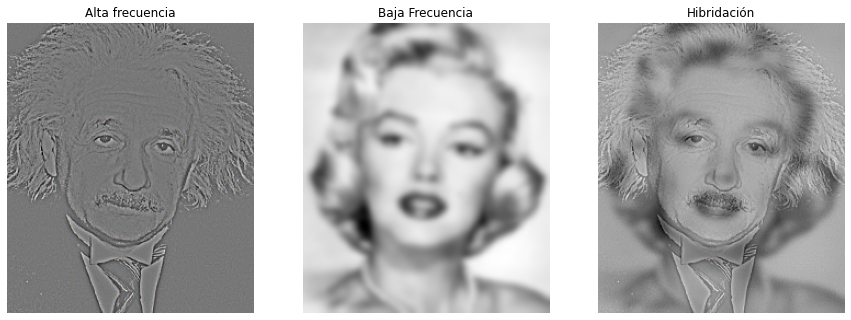

Sigma high:  1.4  - Sigma low:  5


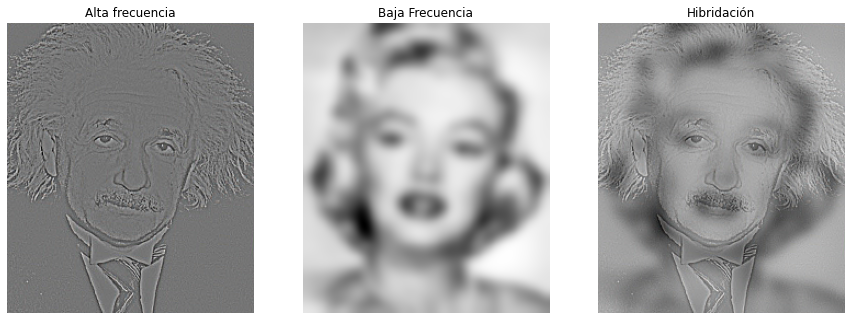

Sigma high:  3  - Sigma low:  5.5


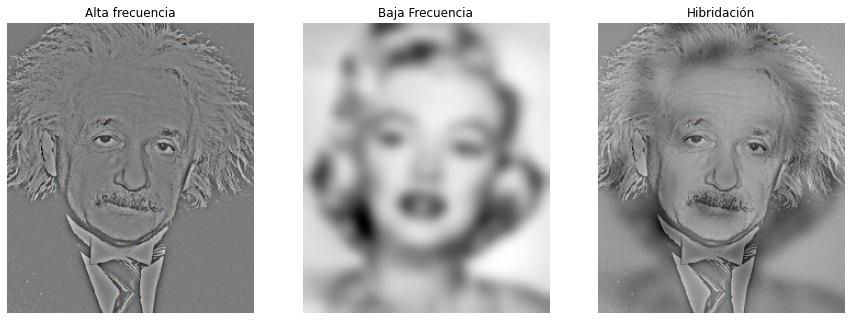

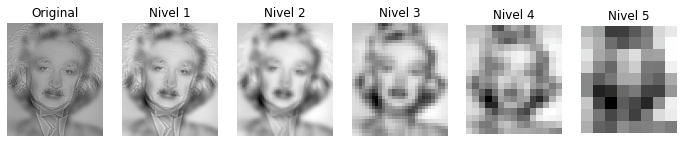

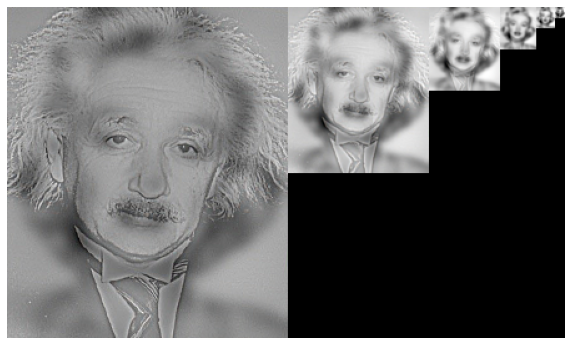

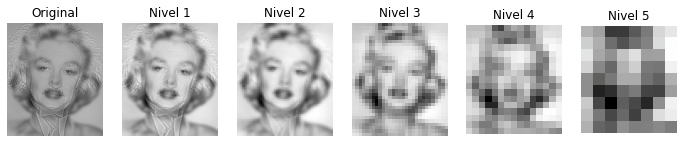

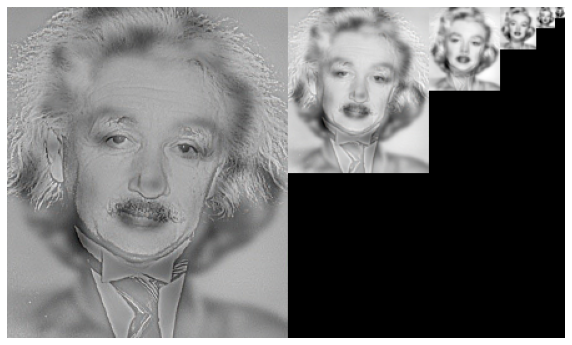

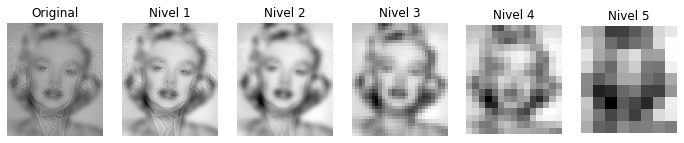

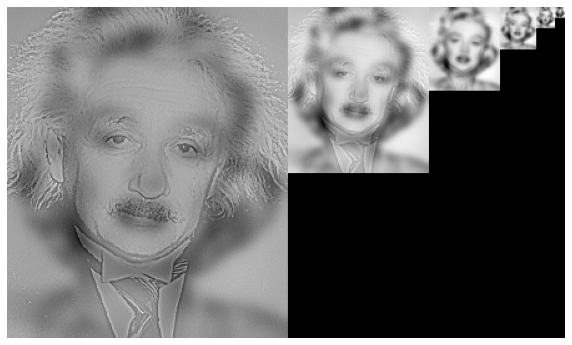

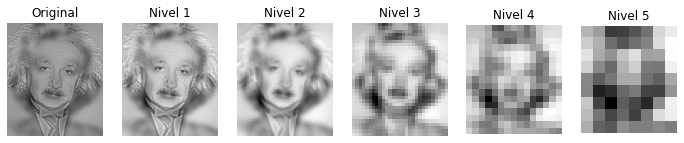

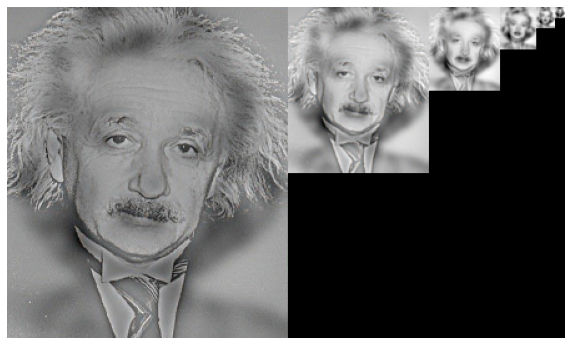

In [138]:
marilenstein_color()

## Bonus C

In [139]:

"""
Función que redimensiona la imagen de entrada al tamaño de la imagen de salida
"""

def redimensionar(entrada,salida):
    shape = (salida.shape[1],salida.shape[0])
    return cv.resize(entrada,shape)

def nicolas_aranda():
    highf   = [12 ,20  ,14]
    lowf  = [15 ,13 ,19]
    modo_padding="reflejado"
    
    limg = cv.imread('data/pilarAranda.jpg', 1)[:,:,::-1]
    himg = cv.imread('data/Nicolas.jpg', 1)[:,:,::-1]
    
    limg = redimensionar(limg,himg)
    
    vhibri = []
    for hsi, lsi in zip(highf,lowf):
        #Hbridacion
        hibry, high, low = hibridacion(himg, limg, hsi, lsi)
        #Visualizacion
        print("Sigma high: ", hsi," - Sigma low: ",lsi)
        vim = [high,low,hibry]
        titles = ["Alta frecuencia","Baja Frecuencia","Hibridación"]
        show_nimages(vim,titles,ncol=3)
        vhibri.append(hibry)
        
    for i in range(len(vhibri)):
        pir = piramideGauss(vhibri[i],sigma=1,lvls=5,modo_reescalado="v1",modo_padding="reflejado")
        showPiramide(pir,ncol=6)

In [ ]:
nicolas_aranda()

In [141]:
def monagrito():
    
    lowf   = [6.5 ,4.5  ,8]
    highf  = [3.9 ,8 ,10]
    modo_padding="reflejado"
    
    limg = cv.imread('data/monalisa.jpg', 1)[:,:,::-1]
    himg = cv.imread('data/elgrito.jpg', 1)[:,:,::-1]
    
    limg = redimensionar(limg,himg)
    
    vhibri = []
    for hsi, lsi in zip(highf,lowf):
        hibry, high, low = hibridacion(himg, limg, hsi, lsi)
        print("Sigma high: ", hsi," - Sigma low: ",lsi)
        vim = [high,low,hibry]
        titles = ["Alta frecuencia","Baja Frecuencia","Hibridación"]
        show_nimages(vim,titles,ncol=3)
        vhibri.append(hibry)
        
    for i in range(len(vhibri)):
        pir = piramideGauss(vhibri[i],sigma=1,lvls=5,modo_reescalado="v1",modo_padding="reflejado")
        showPiramide(pir,ncol=6)

In [ ]:
monagrito()

In [143]:
def monagrito():
    
    lowf   = [6.5 ,4.5  ,8.3]
    highf  = [1 ,2 ,4.5]
    modo_padding="reflejado"
    
    himg = cv.imread('data/monalisa.jpg', 1)[:,:,::-1]
    limg = cv.imread('data/elgrito.jpg', 1)[:,:,::-1]
    
    limg = redimensionar(limg,himg)
    
    vhibri = []
    for hsi, lsi in zip(highf,lowf):
        hibry, high, low = hibridacion(himg, limg, hsi, lsi)
        print("Sigma high: ", hsi," - Sigma low: ",lsi)
        vim = [high,low,hibry]
        titles = ["Alta frecuencia","Baja Frecuencia","Hibridación"]
        show_nimages(vim,titles,ncol=3)
        vhibri.append(hibry)
        
    for i in range(len(vhibri)):
        pir = piramideGauss(vhibri[i],sigma=1,lvls=5,modo_reescalado="v1",modo_padding="reflejado")
        showPiramide(pir,ncol=6)

In [ ]:
monagrito()

In [145]:
def zapapie():
    
    lowf   = [5 ,4.5  ,8.8]
    highf  = [1.2 ,2 ,3]
    modo_padding="reflejado"
    
    himg = cv.imread('data/zapatilla.jpeg', 1)[:,:,::-1]
    limg = cv.imread('data/pie.jpeg', 1)[:,:,::-1]
    
    limg = redimensionar(limg,himg)
    
    vhibri = []
    for hsi, lsi in zip(highf,lowf):
        hibry, high, low = hibridacion(himg, limg, hsi, lsi)
        vim = [high,low,hibry]
        titles = ["Alta frecuencia","Baja Frecuencia","Hibridación"]
        show_nimages(vim,titles,ncol=3)
        vhibri.append(hibry)
        
    for i in range(len(vhibri)):
        pir = piramideGauss(vhibri[i],sigma=1,lvls=5,modo_reescalado="v1",modo_padding="reflejado")
        showPiramide(pir,ncol=6)

In [ ]:
zapapie()